# Magnetic Data Processing

In [7]:
### Ehsan Farahbakhsh and Hugo W. Fahey

#*EarthByte Group, School of Geosciences, University of Sydney, NSW 2006, Australia*

#This notebook enables the user to pre-process the magnetic dataset available for South Australia, reduce the dimensionality of the dataset using the principal component analysis (PCA) method, and apply the k-means clustering method to the output components.

## Importing Libraries

In [8]:
import contextily as cx
import geopandas as gpd
from ipywidgets import interact
import math
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
import os
from osgeo import gdal, osr
import pandas as pd
import rioxarray as rxr
from scipy.interpolate import griddata
from shapely.geometry import mapping
from shapely.geometry import Point
from skimage import exposure, util
from skimage.feature import graycomatrix, graycoprops
from sklearn import cluster
from sklearn.decomposition import PCA
import sys
from tqdm.notebook import tqdm

import warnings
warnings.filterwarnings('ignore')

## Importing Layers

### Vector Files

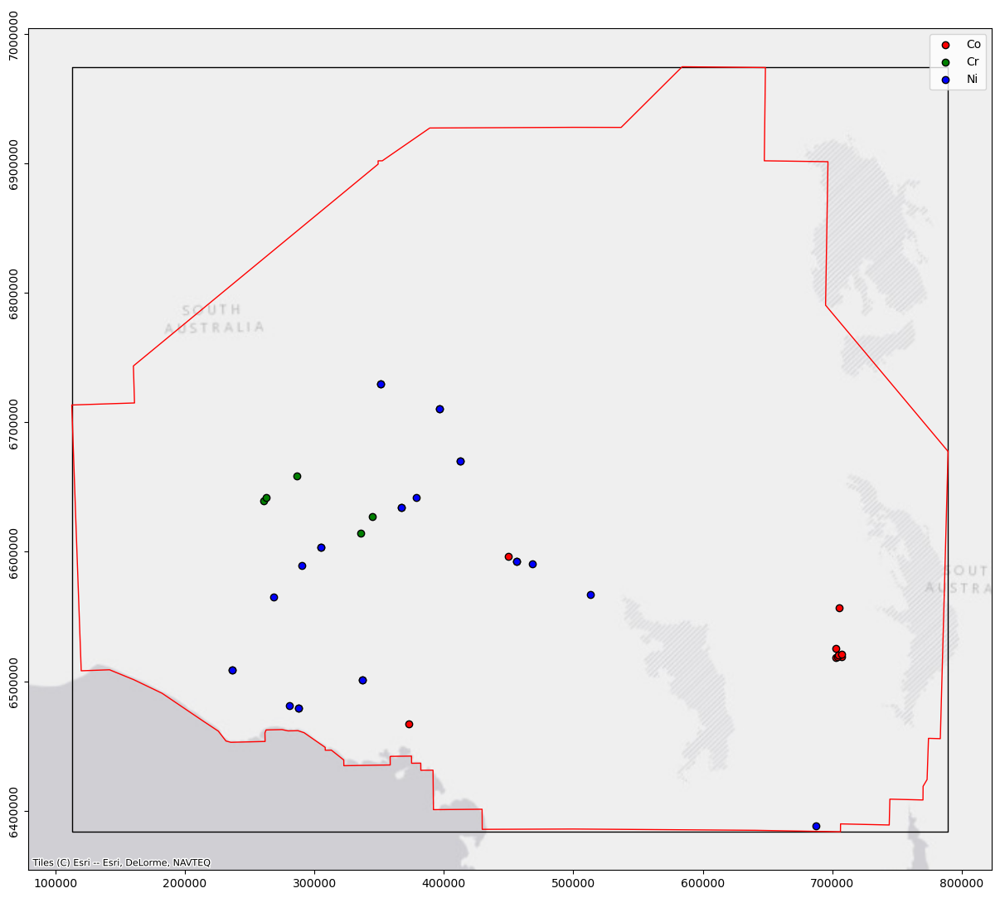

In [9]:
# read boundaries
gc_frame = gpd.read_file('./Datasets/Frames/GC_Frame_MGA53.shp')
gc_frame = gc_frame.to_crs('epsg:7853')
gc_polygon = gpd.read_file('./Datasets/Frames/GC_Polygon_MGA53.shp')
gc_polygon = gc_polygon.to_crs('epsg:7853')
bounds = gc_frame.bounds
extent = [bounds.loc[0]['minx'], bounds.loc[0]['maxx'], bounds.loc[0]['miny'], bounds.loc[0]['maxy']]

# mineral occurrences
mines_co = gpd.read_file('./Datasets/Mineral occurrences/cobalt.shp')
mines_co = mines_co.to_crs('epsg:7853')
mines_co = mines_co.clip(gc_polygon)
mines_cr = gpd.read_file('./Datasets/Mineral occurrences/chromium.shp')
mines_cr = mines_cr.to_crs('epsg:7853')
mines_cr = mines_cr.clip(gc_polygon)
mines_ni = gpd.read_file('./Datasets/Mineral occurrences/nickel.shp')
mines_ni = mines_ni.to_crs('epsg:7853')
mines_ni = mines_ni.clip(gc_polygon)

# target mineralization types
cox_class = ['Deposits related to mafic and ultramafic intrusions in stable environments',
             'Deposits related to mafic-ultramafic rocks in unstable areas']

# plot the mineral occurrences
fig, ax = plt.subplots(figsize=(15, 15))
mines_co.plot(ax=ax, edgecolor='black', color='red')
mines_cr.plot(ax=ax, edgecolor='black', color='green')
mines_ni.plot(ax=ax, edgecolor='black', color='blue')
gc_frame.plot(ax=ax, edgecolor='black', color='none', linewidth=1)
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
# Esri: WorldStreetMap, DeLorme, WorldTopoMap, WorldImagery, WorldTerrain, WorldShadedRelief, WorldPhysical, OceanBasemap,
# NatGeoWorldMap, WorldGrayCanvas
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.legend(['Co', 'Cr', 'Ni'])
plt.grid(False)
plt.show()

### Reduced-to-Pole (RTP) Magnetic Intensity

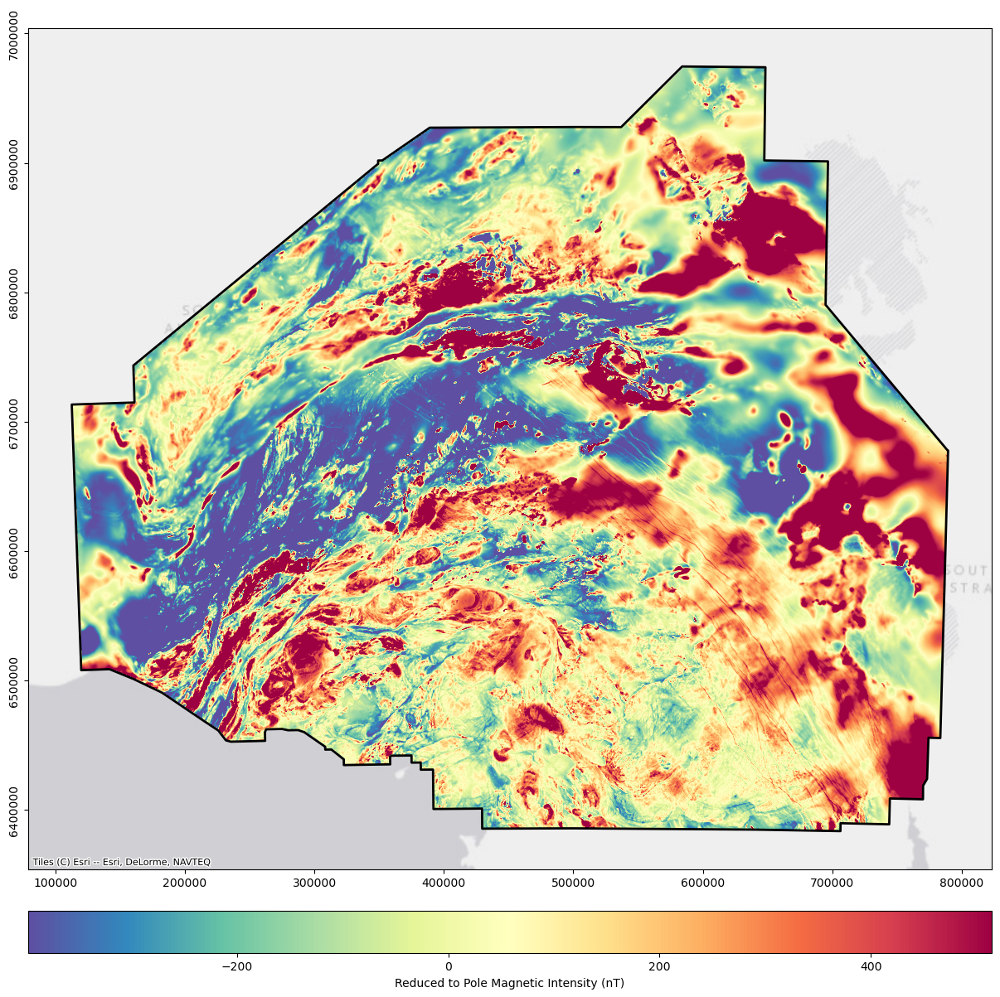

In [10]:
mag_file = './Datasets/Magnetic/SA_TMI_VRTP_GDA94.tif'

raster = rxr.open_rasterio(mag_file).squeeze()
raster = raster.rio.reproject(gc_frame.crs)
raster_clipped = raster.rio.clip(gc_frame.geometry.apply(mapping))
raster_clipped_array = raster_clipped.values

lons = raster_clipped.coords['x'].values
lats = raster_clipped.coords['y'].values
lons_2d = np.tile(lons, (len(lats), 1))
lats_2d = np.transpose(np.tile(lats, (len(lons), 1)))

mag_x = raster_clipped.coords['x'].values
mag_y = np.flipud(raster_clipped.coords['y'].values)
mag_xs, mag_ys = np.meshgrid(mag_x, mag_y)
mag_xs_flat = np.reshape(mag_xs.flatten(), (-1, 1))
mag_ys_flat = np.reshape(mag_ys.flatten(), (-1, 1))
mag_xy = np.hstack([mag_xs_flat, mag_ys_flat])

raster_nan = rxr.open_rasterio(mag_file, masked=True).squeeze()
raster_nan = raster_nan.rio.reproject(gc_polygon.crs)
raster_nan_clipped = raster_nan.rio.clip(gc_polygon.geometry.apply(mapping))
raster_nan_clipped_array = raster_nan_clipped.values
mask = np.isnan(raster_nan_clipped_array)

def plot_array_stretched(array, label):
    fig, ax = plt.subplots(figsize=(15, 15))
    v_mean = np.array(np.nanmean(array))
    v_std = np.array(np.nanstd(array))
    gc_polygon.plot(ax=ax, edgecolor='black', color='none', linewidth=2)
    cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
    plt.yticks(rotation=90, va='center')
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
    cb = ax.imshow(array, cmap='Spectral_r', extent=extent, vmin=v_mean-v_std, vmax=v_mean+v_std)
    divider = make_axes_locatable(ax)
    cax = divider.new_vertical(size='5%', pad=0.5, pack_start=True)
    fig.add_axes(cax)
    plt.colorbar(cb, orientation='horizontal', label=label, cax=cax)
    plt.grid(False)
    plt.show()

def plot_array(array, label):
    fig, ax = plt.subplots(figsize=(15, 15))
    gc_polygon.plot(ax=ax, edgecolor='black', color='none', linewidth=2)
    cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
    plt.yticks(rotation=90, va='center')
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
    cb = ax.imshow(array, cmap='Spectral_r', extent=extent)
    divider = make_axes_locatable(ax)
    cax = divider.new_vertical(size='5%', pad=0.5, pack_start=True)
    fig.add_axes(cax)
    plt.colorbar(cb, orientation='horizontal', label=label, cax=cax)
    plt.grid(False)
    plt.show()

plot_array_stretched(raster_nan_clipped_array, 'Reduced to Pole Magnetic Intensity (nT)')

### Existing Magnetic Data Layers

In [11]:
mag_filenames_01 = [
    './Datasets/Magnetic/SA_TMI_GDA94.tif',
    # './Datasets/Magnetic/SA_TMI_VRTP_1VD_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_AGC_GDA94.tif',
    # './Datasets/Magnetic/SA_TMI_VRTP_AS_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_BigE_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_BigT_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_CAUCHY_3rd_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_PsuedoGrav_GDA94.tif',
    # './Datasets/Magnetic/SA_TMI_VRTP_Tilt_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_TZ_GDA94.tif',
    './Datasets/Magnetic/SA_TMI_VRTP_Tzz_GDA94.tif'
    ]

@interact(mag_file=mag_filenames_01)
def show_dist(mag_file):
    raster = rxr.open_rasterio(mag_file, masked=True).squeeze()
    raster = raster.rio.reproject(gc_polygon.crs)
    raster_clipped = raster.rio.clip(gc_polygon.geometry.apply(mapping))
    raster_clippd = raster_clipped.values
    plot_array_stretched(raster_clipped, os.path.splitext(os.path.basename(mag_file))[0])

interactive(children=(Dropdown(description='mag_file', options=('./Datasets/Magnetic/SA_TMI_GDA94.tif', './Dat…

## Target Points

Number of samples: 73561


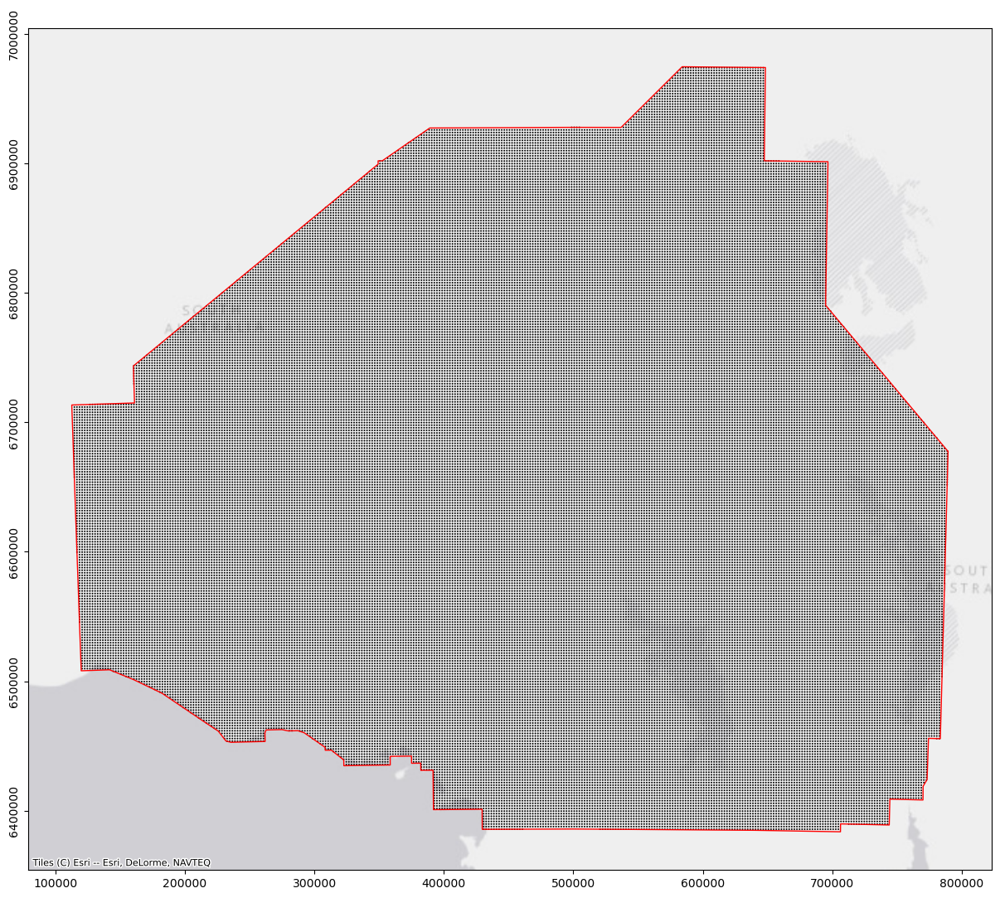

In [12]:
# set the sampling resolution in meter
dist_x, dist_y = (2000, 2000)
x = np.arange(extent[0], extent[1], dist_x)
y = np.arange(extent[2], extent[3], dist_y)
nx = len(x)
ny = len(y)
xs, ys = np.meshgrid(x, y)
xs_flat = xs.flatten()
ys_flat = ys.flatten()

sample_x = []
sample_y = []
sample_mask = []
for xx, yy in zip(xs_flat, ys_flat):
    p = Point((xx, yy))
    if p.within(gc_polygon.geometry[0]):
        sample_x.append(xx)
        sample_y.append(yy)
        sample_mask.append(True)
    else:
        sample_mask.append(False)

sample_coords = pd.DataFrame(sample_x, columns=['X'])
sample_coords['Y'] = sample_y
mask_x = np.array([xs_flat]).T
mask_y = np.array([ys_flat]).T
sample_mask = np.array([sample_mask]).T
mask_coords = np.hstack((mask_x, mask_y, sample_mask))

print('Number of samples:', len(sample_x))

mask_2d = np.reshape(sample_mask, (ny, nx))
mask_2d_ud = np.flipud(mask_2d)

fig, ax = plt.subplots(figsize=(15,15))
ax.scatter(sample_x, sample_y, color='black',  edgecolors='none', s=2)
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.show()

## Gray Level Co-occurrence Matrix (GLCM) Filters

In [13]:
# calculate mean and standard deviation in a buffer zone (circle) surrounding each sampling point
# the raster data frame and the frame used to generate sampling points must be the same
def get_mean_std(xs, ys, raster, bounds, radius):
    points = [Point(x, y) for x, y in zip(xs, ys)]
    means = []
    stds = []
    
    for point in tqdm(points):
        x = point.x
        y = point.y
        xx = []
        yy = []
        
        # prevent nan values
        if x < bounds[0]:
            x = bounds[0]
        if x > bounds[2]:
            x = bounds[2]
        if y < bounds[1]:
            y = bounds[1]
        if y > bounds[3]:
            y = bounds[3]

        x_origin = math.floor((x-bounds[0])/(bounds[2]-bounds[0])*(raster.shape[1]-1))
        y_origin = math.floor((y-bounds[1])/(bounds[3]-bounds[1])*(raster.shape[0]-1))

        radius = math.ceil(radius*raster.shape[1]/(bounds[2]-bounds[0]))
        points_circle = []

        for xr in range(-radius, radius+1):
            Y = int((radius*radius-xr*xr)**0.5)
            for yr in range(-Y, Y+1):
                xc = xr + x_origin
                yc = yr + y_origin
                if xc >= 0 and xc <= raster.shape[1]-1 and yc >= 0 and yc <= raster.shape[0]-1:
                    points_circle.append((xc, yc))

        for p in points_circle:
            xx.append(p[0])
            yy.append(raster.shape[0]-1-p[1])
        
        means.append(np.nanmean(raster[yy, xx]))
        stds.append(np.nanstd(raster[yy, xx]))

    return means, stds

# glcm texture features in a window (square) surrounding each sampling point
def get_glcm(xs, ys, raster, bounds, patch_size):
    points = [Point(x, y) for x, y in zip(xs, ys)]
    dissimilarity = []
    correlation = []
    
    for point in tqdm(points):
        x = point.x
        y = point.y
        
        left = max(x-patch_size/2, bounds[0])
        right = min(x+patch_size/2, bounds[2])
        top = min(y+patch_size/2, bounds[3])
        bottom = max(y-patch_size/2, bounds[1])
        
        left_idx = math.floor((left-bounds[0])/(bounds[2]-bounds[0])*(raster.shape[1]-1))
        right_idx = math.floor((right-bounds[0])/(bounds[2]-bounds[0])*(raster.shape[1]-1))
        bottom_idx = math.floor((bottom-bounds[1])/(bounds[3]-bounds[1])*(raster.shape[0]-1))
        top_idx = math.floor((top-bounds[1])/(bounds[3]-bounds[1])*(raster.shape[0]-1))

        xs = np.arange(left_idx, right_idx+1)
        ys = np.arange(raster.shape[0]-1-top_idx, raster.shape[0]-1-bottom_idx+1)
        xm, ym = np.meshgrid(xs, ys)
        
        if np.isnan(raster[ym, xm]).all():
            dissimilarity.append(np.nan)
            correlation.append(np.nan)
        else:
            raster_scaled = exposure.rescale_intensity(raster[ym, xm], in_range=(np.nanmin(raster[ym, xm]), np.nanmax(raster[ym, xm])), out_range=(0, 1))
            raster_ubyte = util.img_as_ubyte(raster_scaled)
            glcm = graycomatrix(raster_ubyte, distances=[5], angles=[0], levels=256, symmetric=True, normed=True)
            dissimilarity.append(graycoprops(glcm, 'dissimilarity')[0, 0])
            correlation.append(graycoprops(glcm, 'correlation')[0, 0])
    
    return dissimilarity, correlation

In [14]:
### Cell Size

In [15]:
x0 = lons_2d[0, 0]
xr = lons_2d[0, 1]
xd = lons_2d[1, 0]

y0 = lats_2d[0, 0]
yr = lats_2d[0, 1]
yd = lats_2d[1, 0]

size_x = math.sqrt(((xr-x0)**2)+((yr-y0)**2))
size_y = math.sqrt(((xd-x0)**2)+((yd-y0)**2))

print('Cell Size (X): ', size_x)
print('Cell Size (Y): ', size_y)

Cell Size (X):  79.5252276789397
Cell Size (Y):  79.5252276789397


## Export Function

In [16]:
# export an array to a GeoTIFF file
def save_tiff(array, index):
    dist_x = 2000
    dist_y = 2000
    geotransform = (extent[0], dist_x, 0, extent[3], 0, -dist_y)
    map_file = f'./Datasets/Resistivity/Interpolated/res_{index}.tiff'
    driver = gdal.GetDriverByName('GTiff')
    nx = array.shape[1]
    ny = array.shape[0]
    dataset = driver.Create(map_file, nx, ny, 1, gdal.GDT_Float32)
    dataset.SetGeoTransform(geotransform)
    srs = osr.SpatialReference()
    srs.ImportFromEPSG(7853)
    dataset.SetProjection(srs.ExportToWkt())
    dataset.GetRasterBand(1).WriteArray(array)
    dataset.FlushCache()
    dataset = None

## Import filters

In [17]:
# import filters
sys.path.append('codes/')
from codes import derivative, auxiliars, filtering

# Processing

## Upward Continuation

In [18]:
### Upward Continuation (5 km)

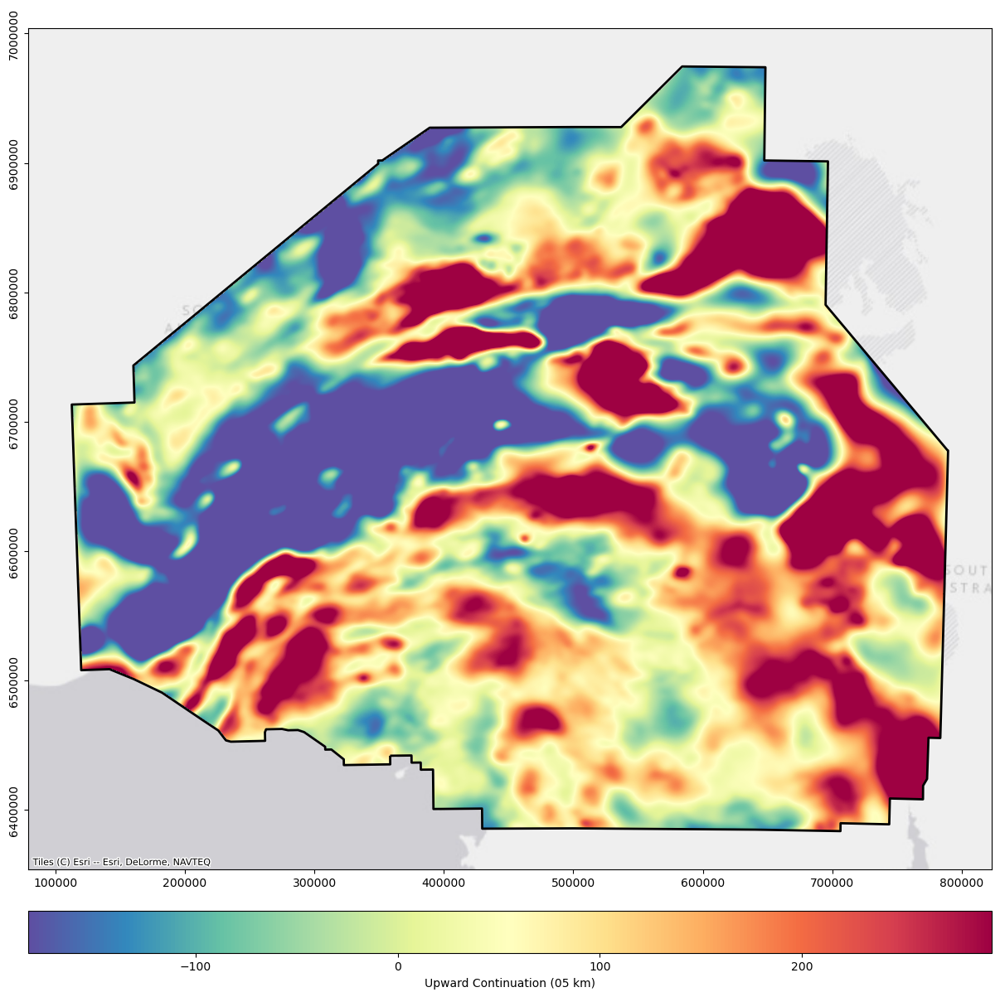

In [19]:
upcont_file = './Datasets/Magnetic/New/upcont05.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of the dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont05 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 5000)
    upcont_2d = np.reshape(upcont05, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont05')

upcont05 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont05.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values

plot_array_stretched(upcont_clipped_array, 'Upward Continuation (05 km)')

In [20]:
### Upward Continuation (10 km)

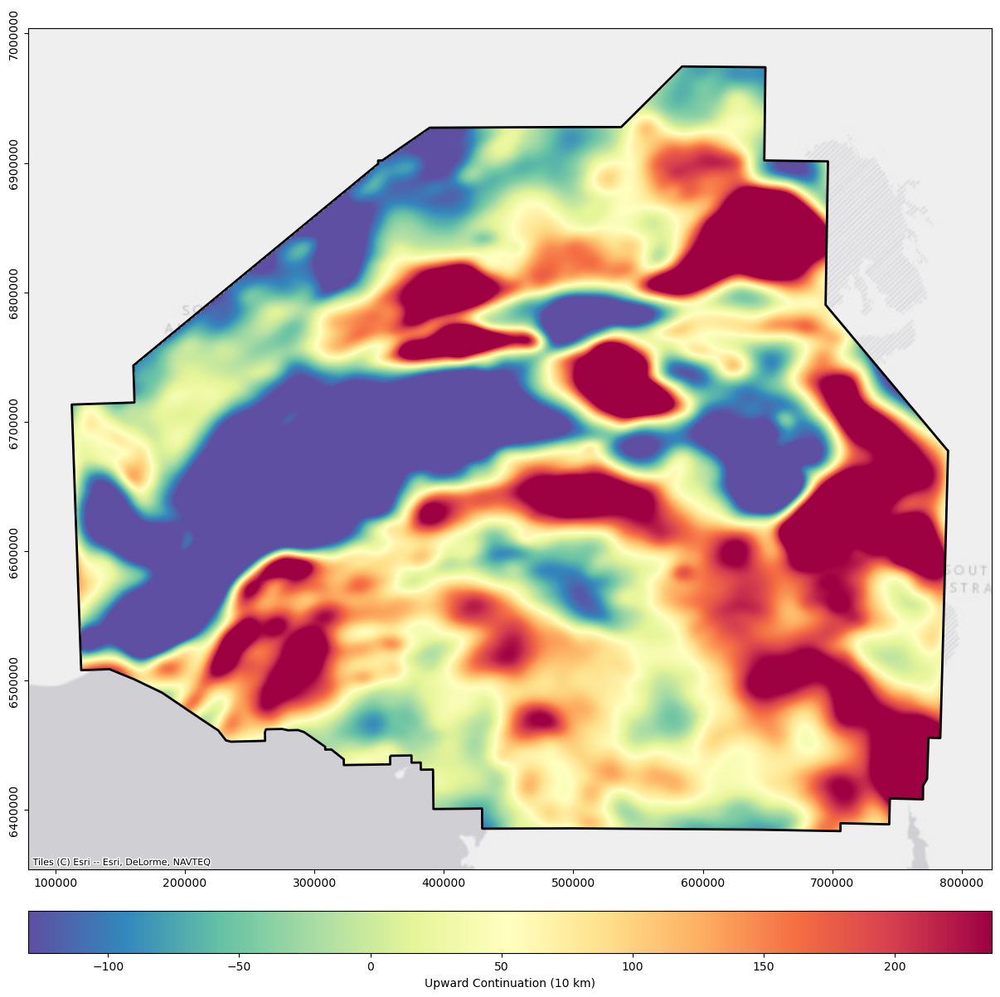

In [21]:
upcont_file = './Datasets/Magnetic/New/upcont10.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of the dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont10 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 10000)
    upcont_2d = np.reshape(upcont10, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont10')

upcont10 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont10.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values
plot_array_stretched(upcont_clipped_array, 'Upward Continuation (10 km)')

In [22]:
### Upward Continuation (20 km)

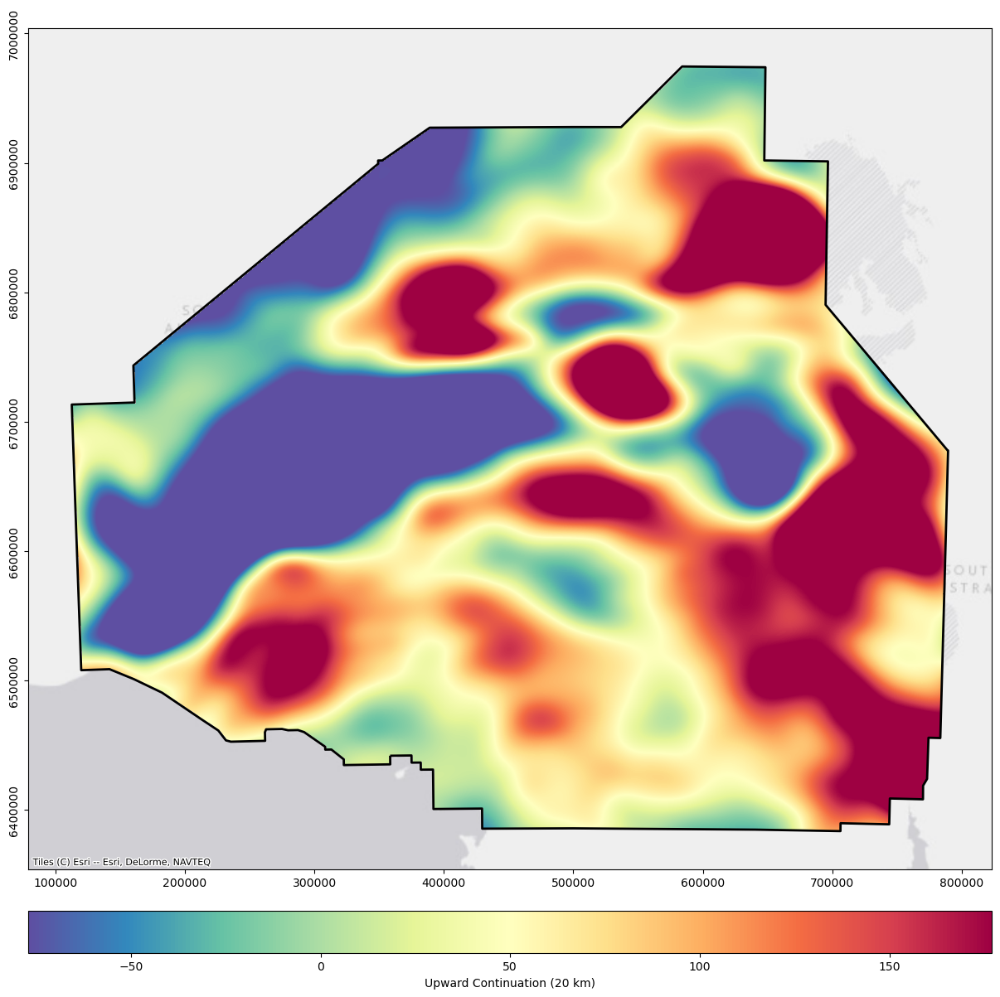

In [23]:
upcont_file = './Datasets/Magnetic/New/upcont20.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of the dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont20 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 20000)
    upcont_2d = np.reshape(upcont20, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont20')

upcont20 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont20.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values

plot_array_stretched(upcont_clipped_array, 'Upward Continuation (20 km)')


In [24]:
### Upward Continuation (30 km)

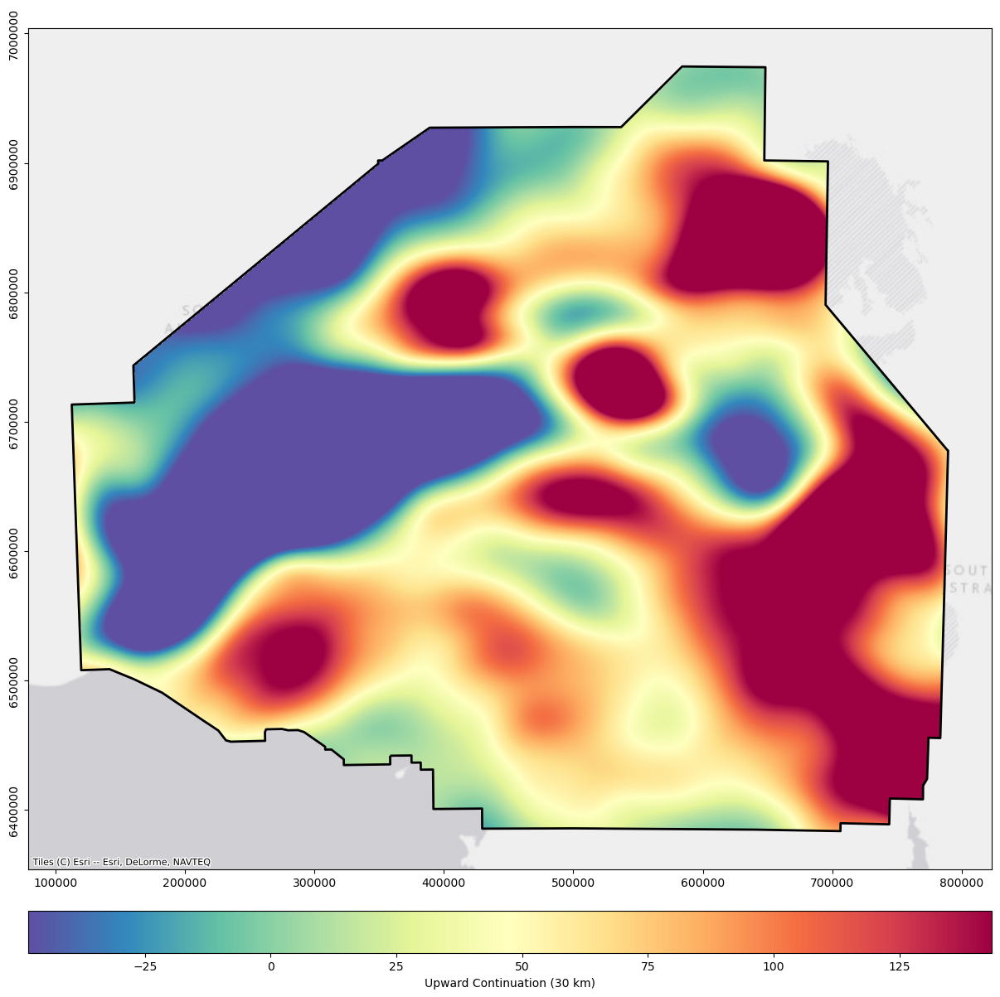

In [25]:
upcont_file = './Datasets/Magnetic/New/upcont30.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of the dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont30 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 30000)
    upcont_2d = np.reshape(upcont30, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont30')

upcont30 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont30.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values
plot_array_stretched(upcont_clipped_array, 'Upward Continuation (30 km)')

## Analytic Signal

In [26]:
### Analytic Signal Upward Continuation (5 km)

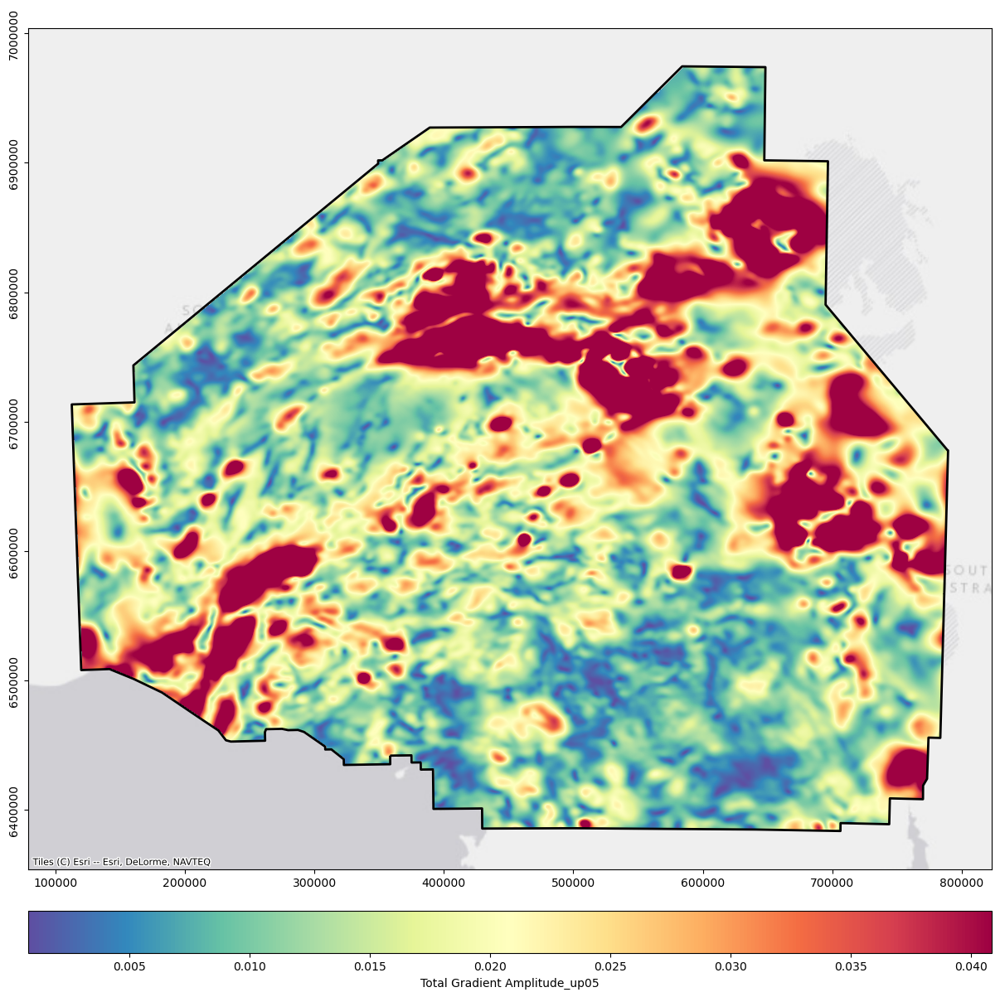

In [27]:
tga_file = './Datasets/Magnetic/New/tga_up05.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up05 = derivative.my_totalgrad(lons_2d, lats_2d, upcont05)
    tga_2d = np.reshape(tga_up05, np.shape(upcont05))
    save_tiff(tga_2d, 'tga_up05')

tga_up05 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up05.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up05')

In [28]:
### Analytic Signal Upward Continuation (10 km)

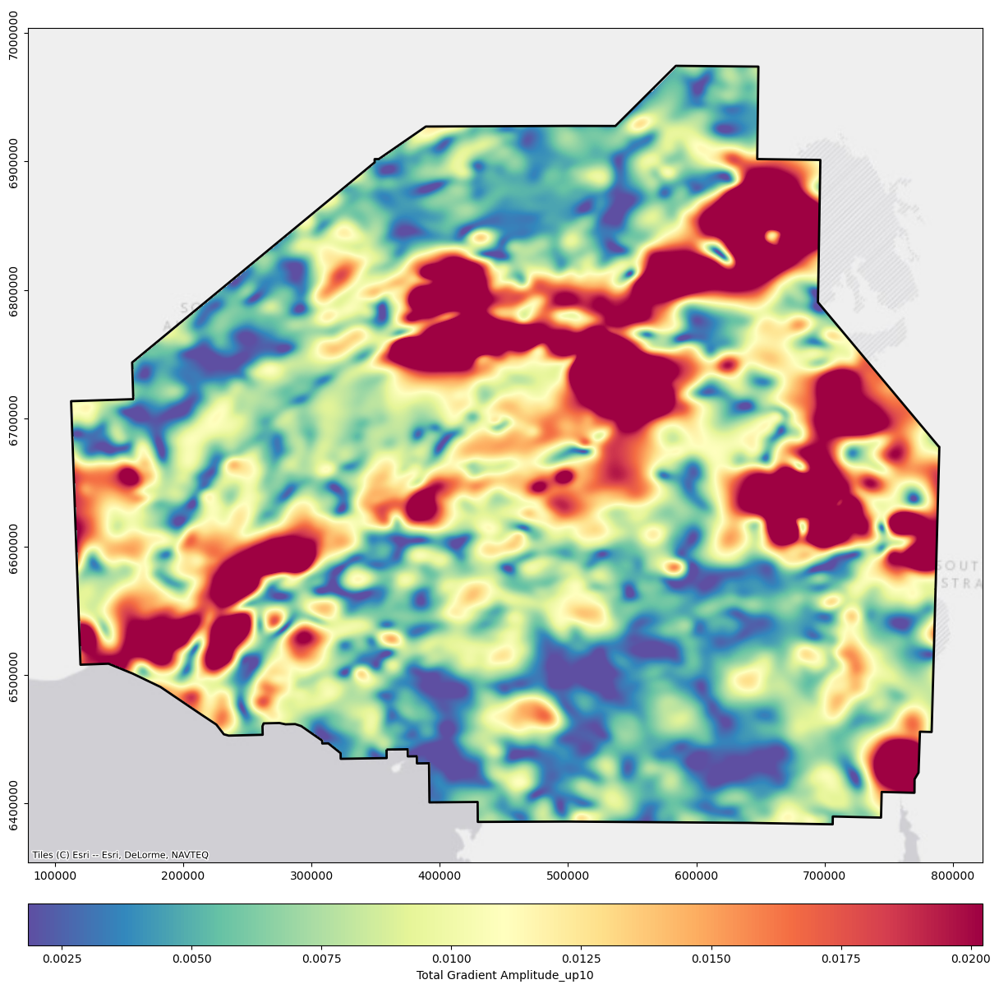

In [29]:
tga_file = './Datasets/Magnetic/New/tga_up10.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up10 = derivative.my_totalgrad(lons_2d, lats_2d, upcont10)
    tga_2d = np.reshape(tga_up10, np.shape(upcont10))
    save_tiff(tga_2d, 'tga_up10')

tga_up10 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up10.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up10')

In [30]:
### Analytic Signal Upward Continuation (20 km)

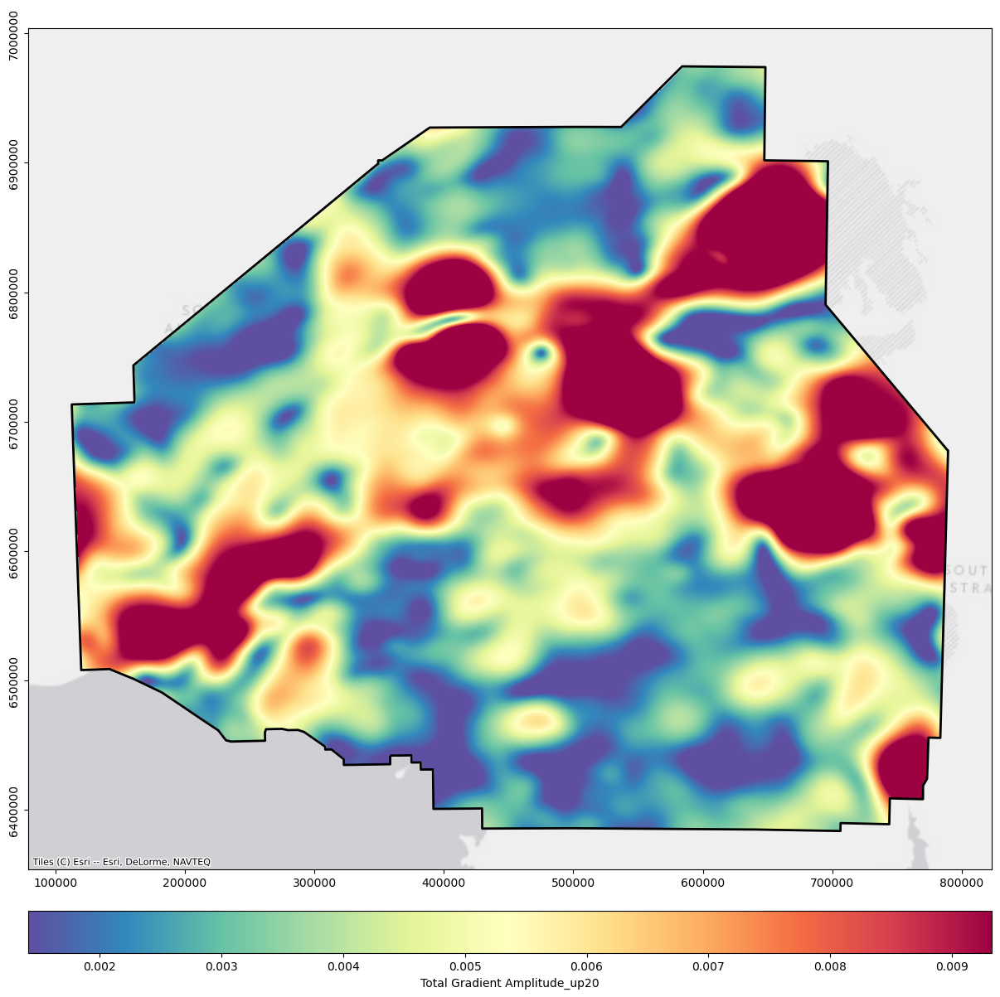

In [31]:
tga_file = './Datasets/Magnetic/New/tga_up20.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up20 = derivative.my_totalgrad(lons_2d, lats_2d, upcont20)
    tga_2d = np.reshape(tga_up20, np.shape(upcont20))
    save_tiff(tga_2d, 'tga_up20')

tga_up20 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up20.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up20')


In [32]:
### Analytic Signal Upward Continuation (30 km)

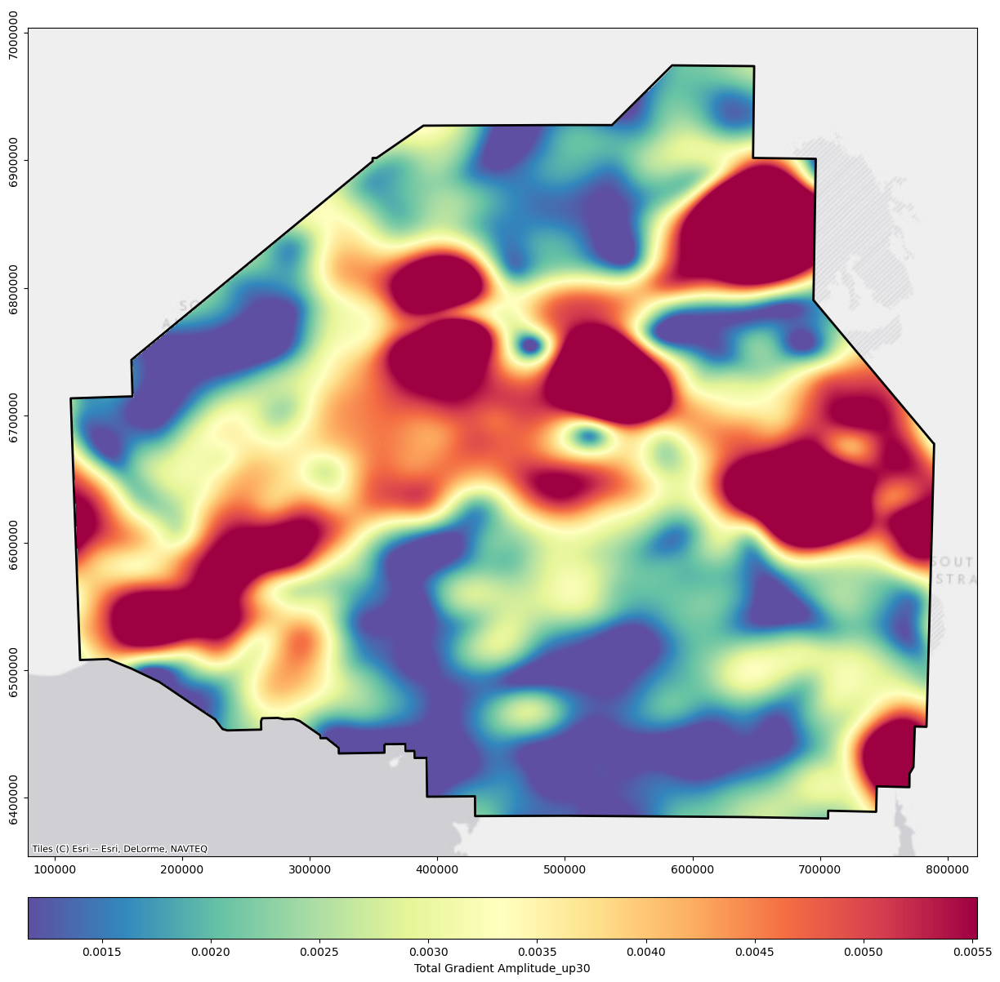

In [33]:
tga_file = './Datasets/Magnetic/New/tga_up30.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up30 = derivative.my_totalgrad(lons_2d, lats_2d, upcont30)
    tga_2d = np.reshape(tga_up30, np.shape(upcont30))
    save_tiff(tga_2d, 'tga_up30')

tga_up30 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up30.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up30')

## Tilt Angle

In [34]:
### Tilt Angle Upward Continuation (05 km)

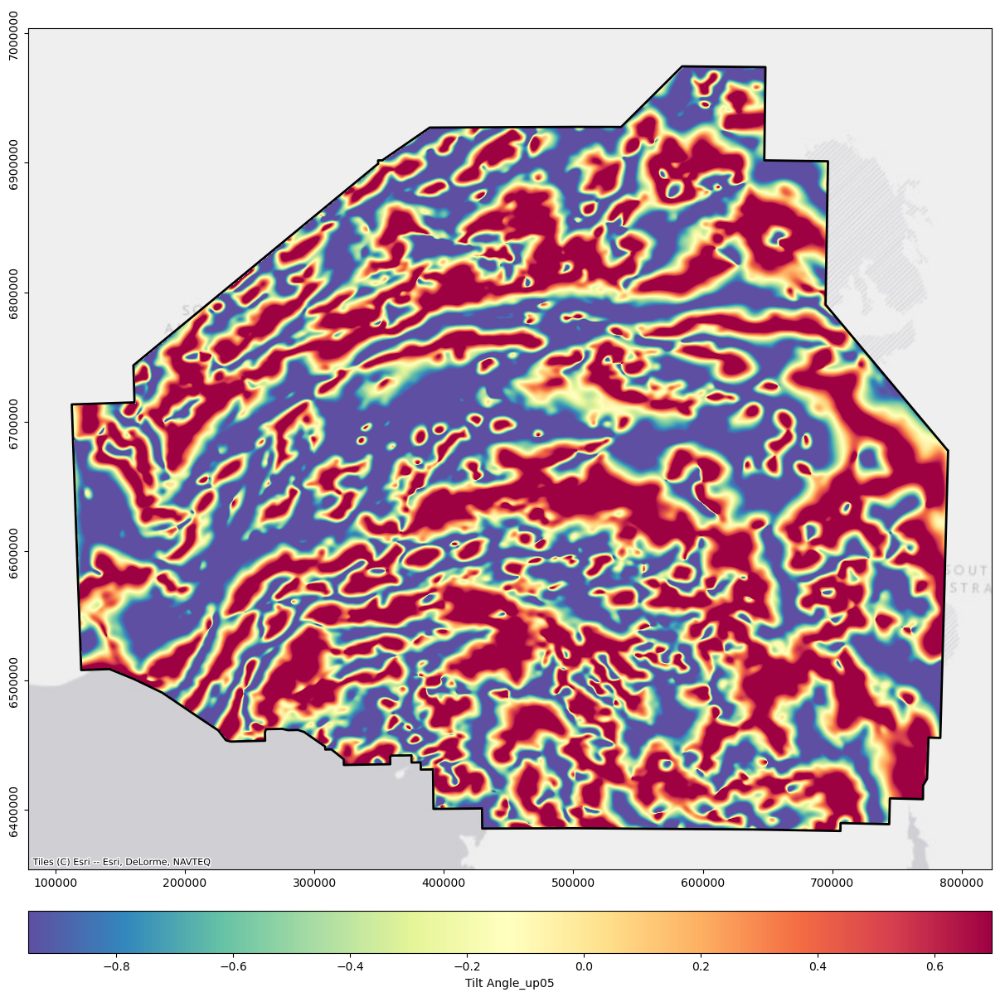

In [35]:
tilt_angle_file = './Datasets/Magnetic/New/tilt_angle_up05.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up05 = filtering.my_tilt(lons_2d, lats_2d, upcont05)
    tilt_angle_2d = np.reshape(tilt_angle_up05, np.shape(upcont05))
    save_tiff(tilt_angle_2d, 'tilt_angle_up05')

tilt_angle_up05 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up05.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up05')

In [36]:
### Tilt Angle Upward Continuation (10 km)

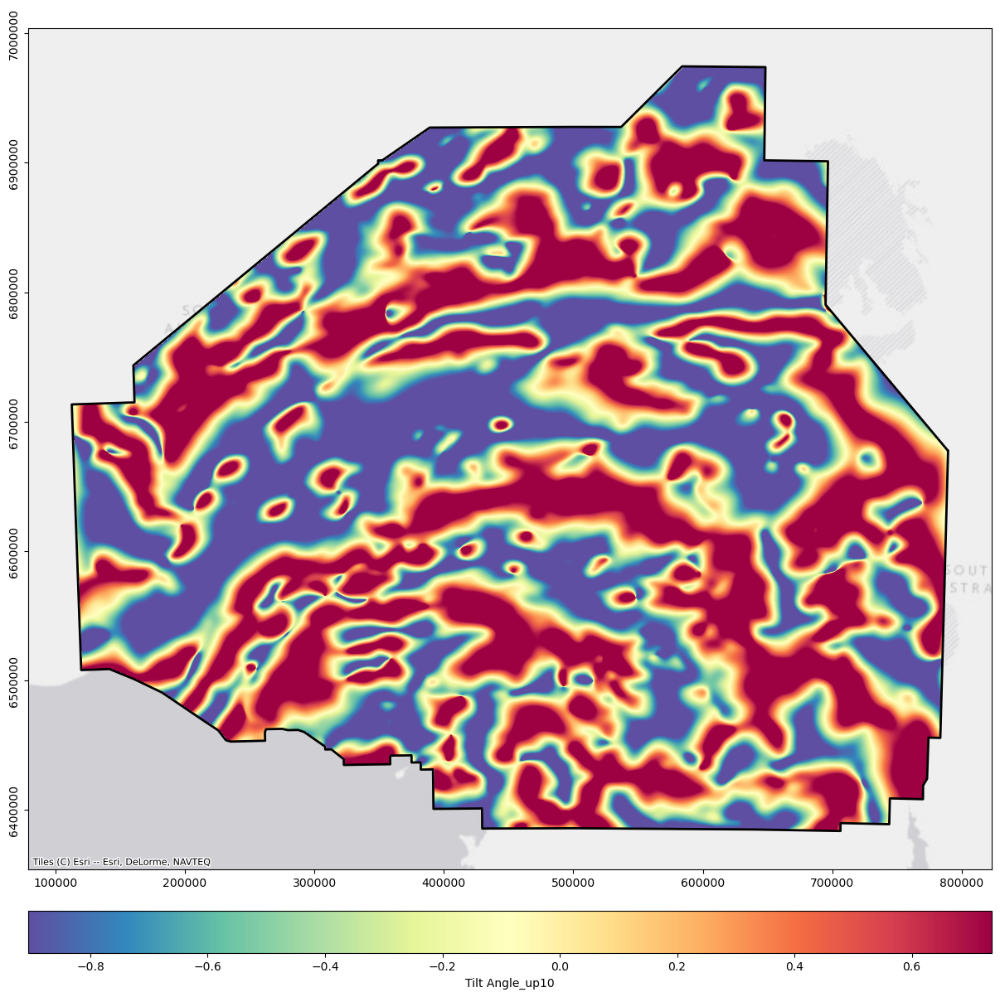

In [37]:
tilt_angle_file = './Datasets/Magnetic/New/tilt_angle_up10.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up10 = filtering.my_tilt(lons_2d, lats_2d, upcont10)
    tilt_angle_2d = np.reshape(tilt_angle_up10, np.shape(upcont10))
    save_tiff(tilt_angle_2d, 'tilt_angle_up10')

tilt_angle_up10 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up10.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up10')

In [38]:
### Tilt Angle Upward Continuation (20 km)

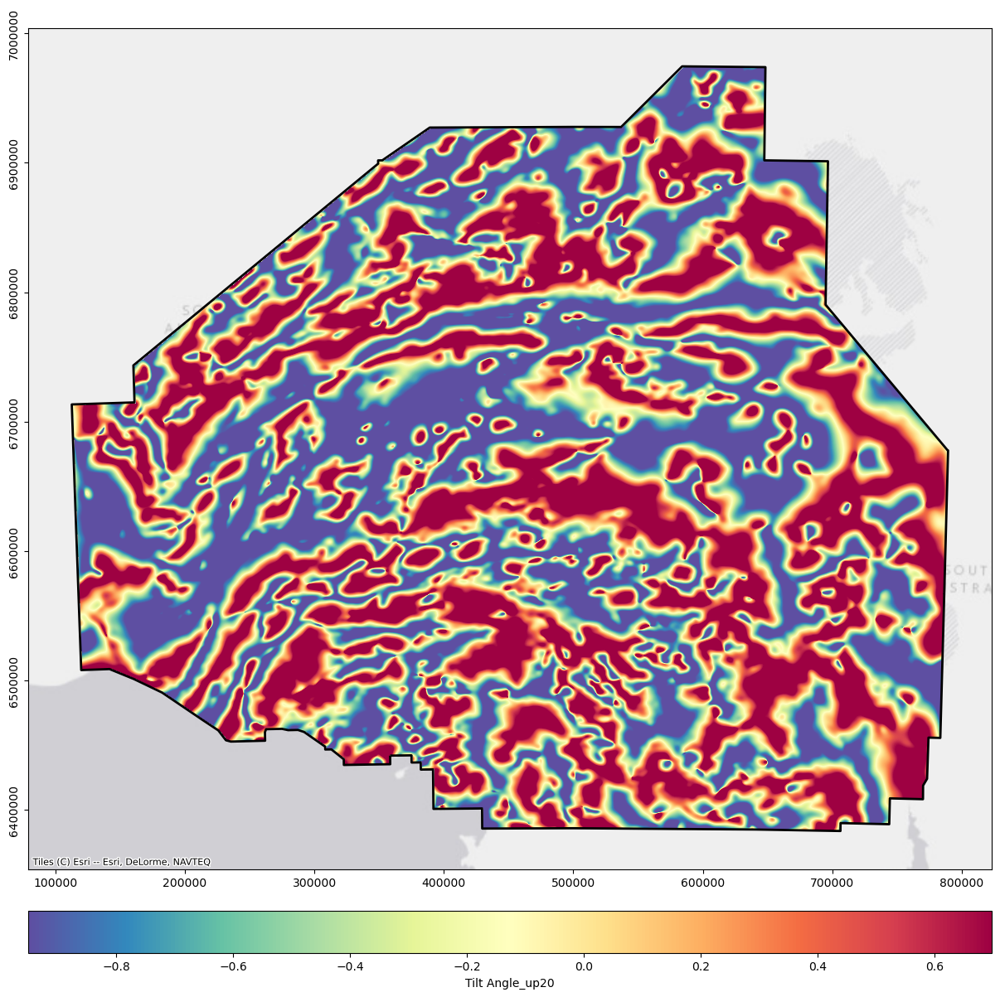

In [39]:
tilt_angle_file = './Datasets/Magnetic/New/tilt_angle_up20.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up20 = filtering.my_tilt(lons_2d, lats_2d, upcont20)
    tilt_angle_2d = np.reshape(tilt_angle_up20, np.shape(upcont20))
    save_tiff(tilt_angle_2d, 'tilt_angle_up20')

tilt_angle_up20 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up20.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up20')

In [40]:
### Tilt Angle Upward Continuation (30 km)

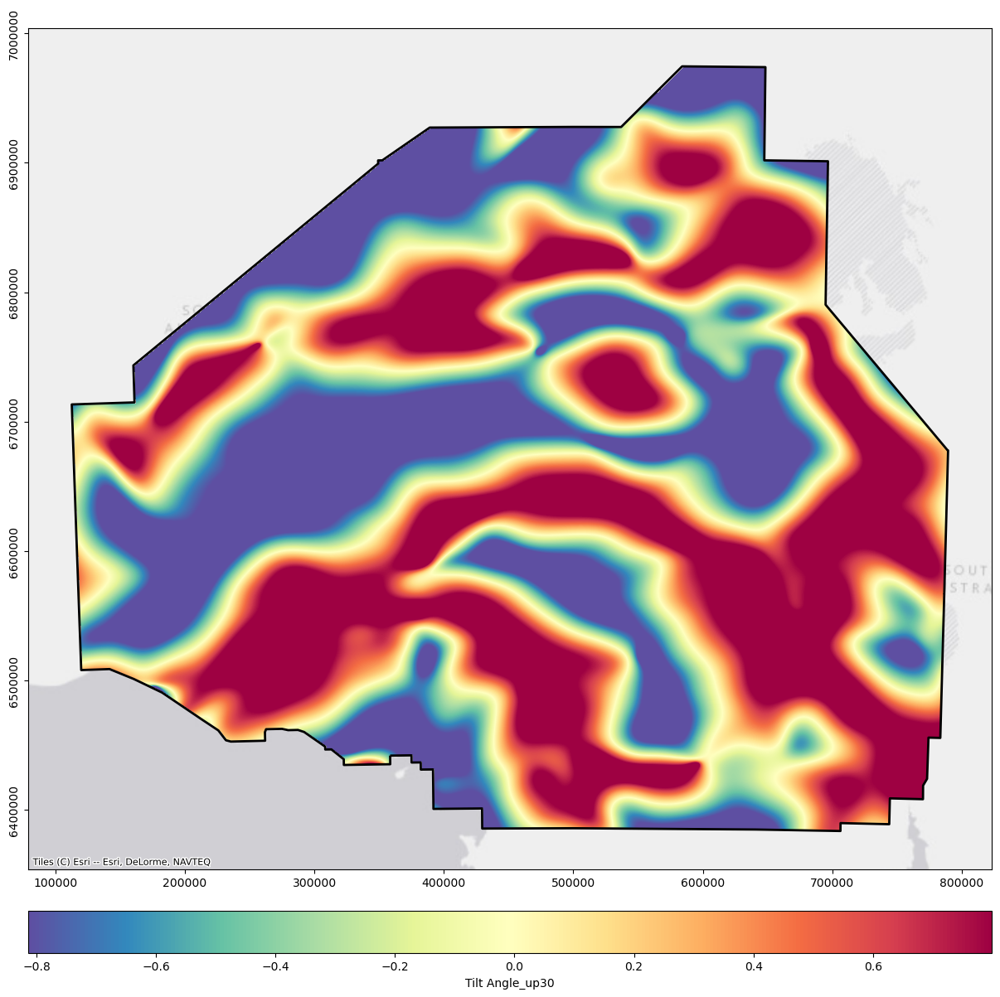

In [41]:
tilt_angle_file = './Datasets/Magnetic/New/tilt_angle_up30.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up30 = filtering.my_tilt(lons_2d, lats_2d, upcont30)
    tilt_angle_2d = np.reshape(tilt_angle_up30, np.shape(upcont30))
    save_tiff(tilt_angle_2d, 'tilt_angle_up30')

tilt_angle_up30 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up30.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up30')

## Horizontal Tilt Angle

In [42]:
### Horizontal Tilt Angle Upward Continuation (05 km)

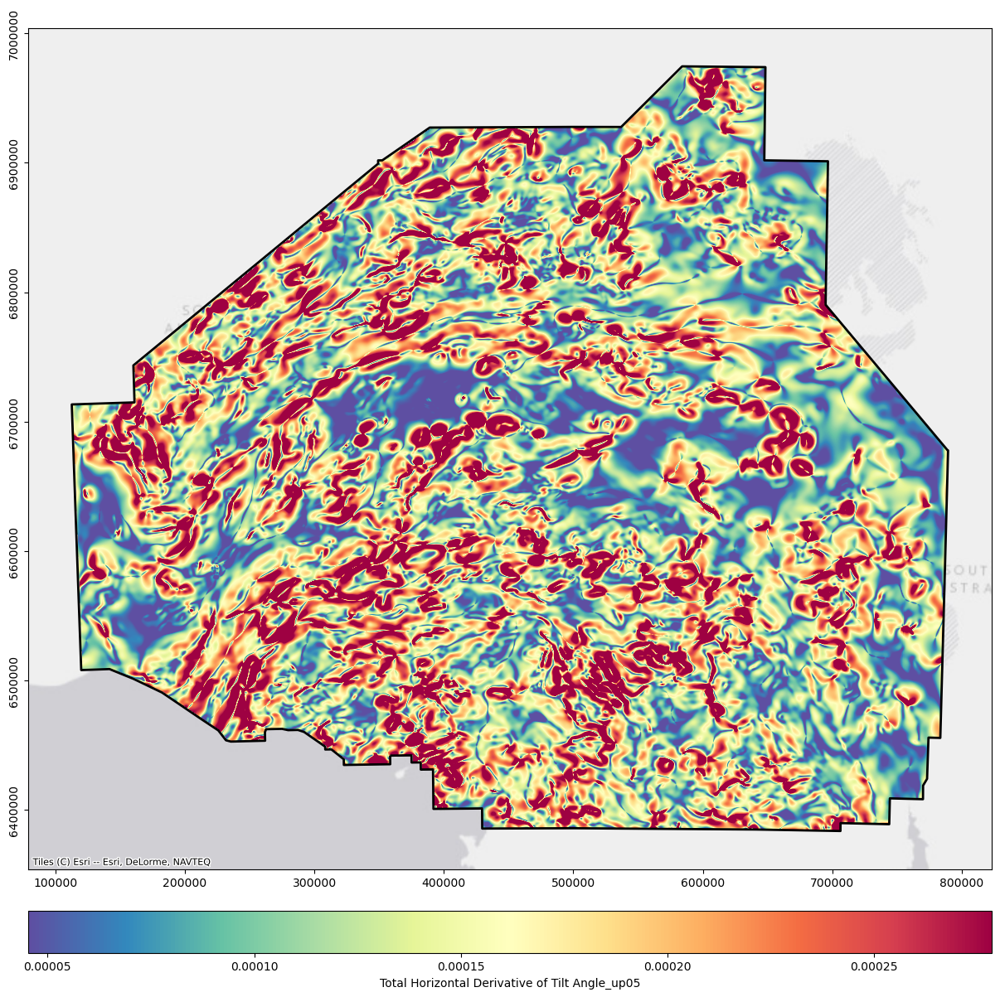

In [43]:
thd_file = './Datasets/Magnetic/New/thd_up05.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up05 = filtering.my_thdr(lons_2d, lats_2d, upcont05)
    thd_2d = np.reshape(thd_up05, np.shape(upcont05))
    save_tiff(thd_2d, 'thd_up05')

thd_up05 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up05.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up05')

In [44]:
### Horizontal Tilt Angle Upward Continuation (10 km)

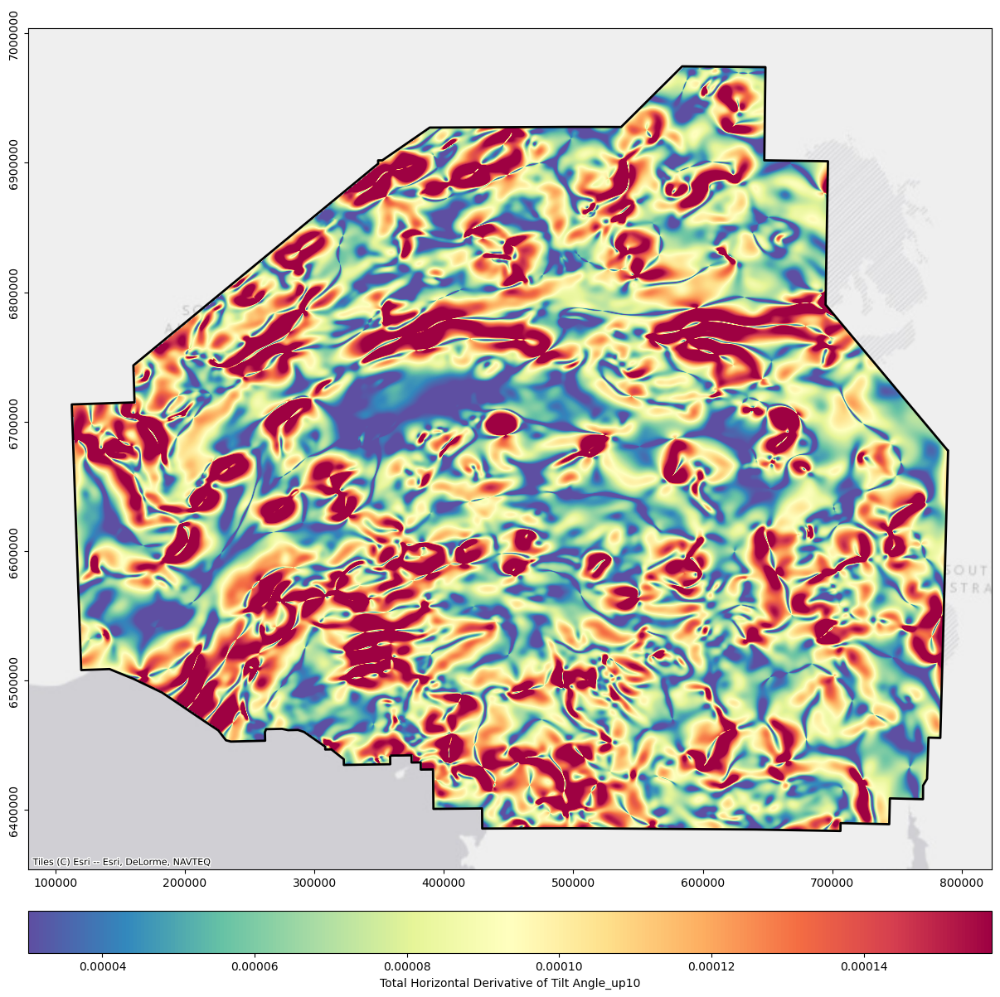

In [45]:
thd_file = './Datasets/Magnetic/New/thd_up10.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up10 = filtering.my_thdr(lons_2d, lats_2d, upcont10)
    thd_2d = np.reshape(thd_up10, np.shape(upcont10))
    save_tiff(thd_2d, 'thd_up10')

thd_up10 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up10.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up10')

In [46]:
### Horizontal Tilt Angle Upward Continuation (20 km)

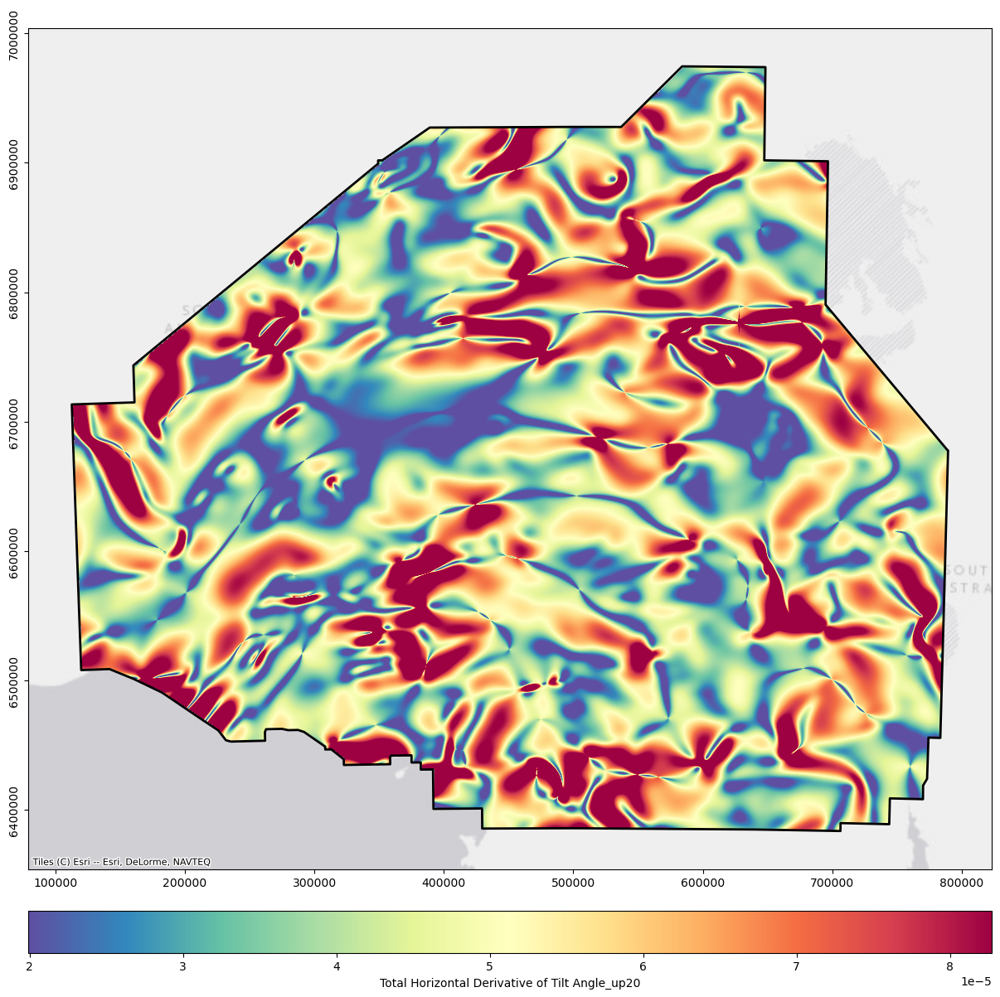

In [47]:
thd_file = './Datasets/Magnetic/New/thd_up20.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up20 = filtering.my_thdr(lons_2d, lats_2d, upcont20)
    thd_2d = np.reshape(thd_up20, np.shape(upcont20))
    save_tiff(thd_2d, 'thd_up20')

thd_up20 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up20.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up20')

In [48]:
### Horizontal Tilt Angle Upward Continuation (30 km)

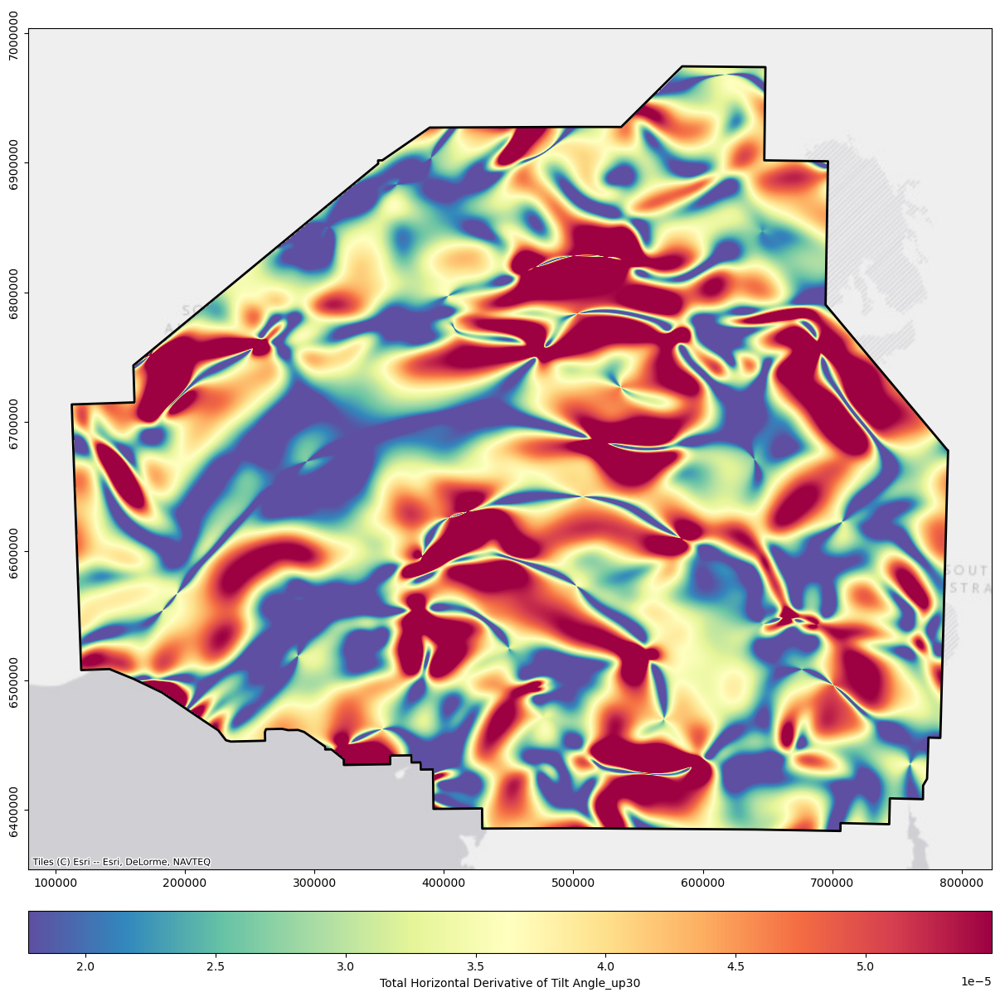

In [49]:
thd_file = './Datasets/Magnetic/New/thd_up30.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up30 = filtering.my_thdr(lons_2d, lats_2d, upcont30)
    thd_2d = np.reshape(thd_up30, np.shape(upcont30))
    save_tiff(thd_2d, 'thd_up30')

thd_up30 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up30.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up30')

## Horizontal Derivatives (X)

In [50]:
#Horizontal Derivatives (X) Upward Continuation (05 km)

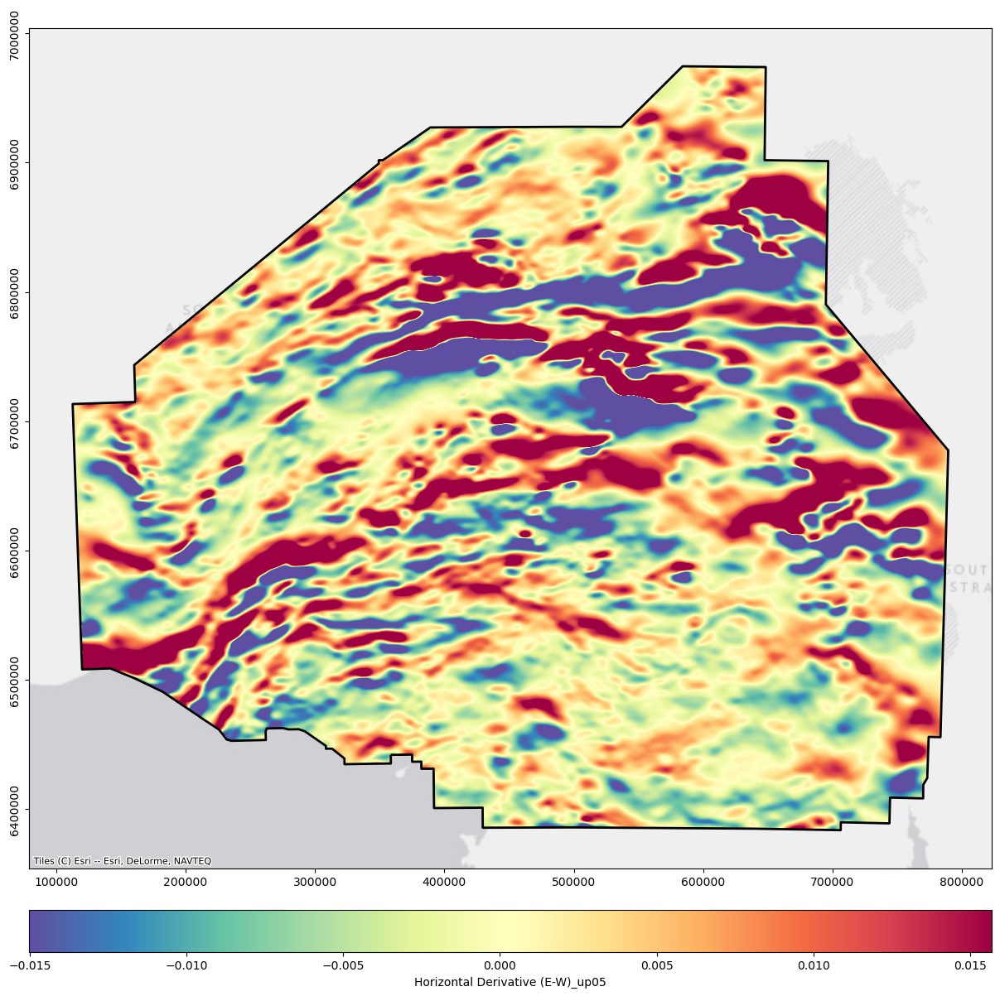

In [51]:
deriv_x_file = './Datasets/Magnetic/New/deriv_x_up05.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up05 = derivative.my_xderiv(lons_2d, lats_2d, upcont05, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up05, np.shape(upcont05))
    save_tiff(derivx_2d, 'deriv_x_up05')

deriv_x_up05 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up05.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative (E-W)_up05')

In [52]:
#Horizontal Derivatives (X) Upward Continuation (10 km)

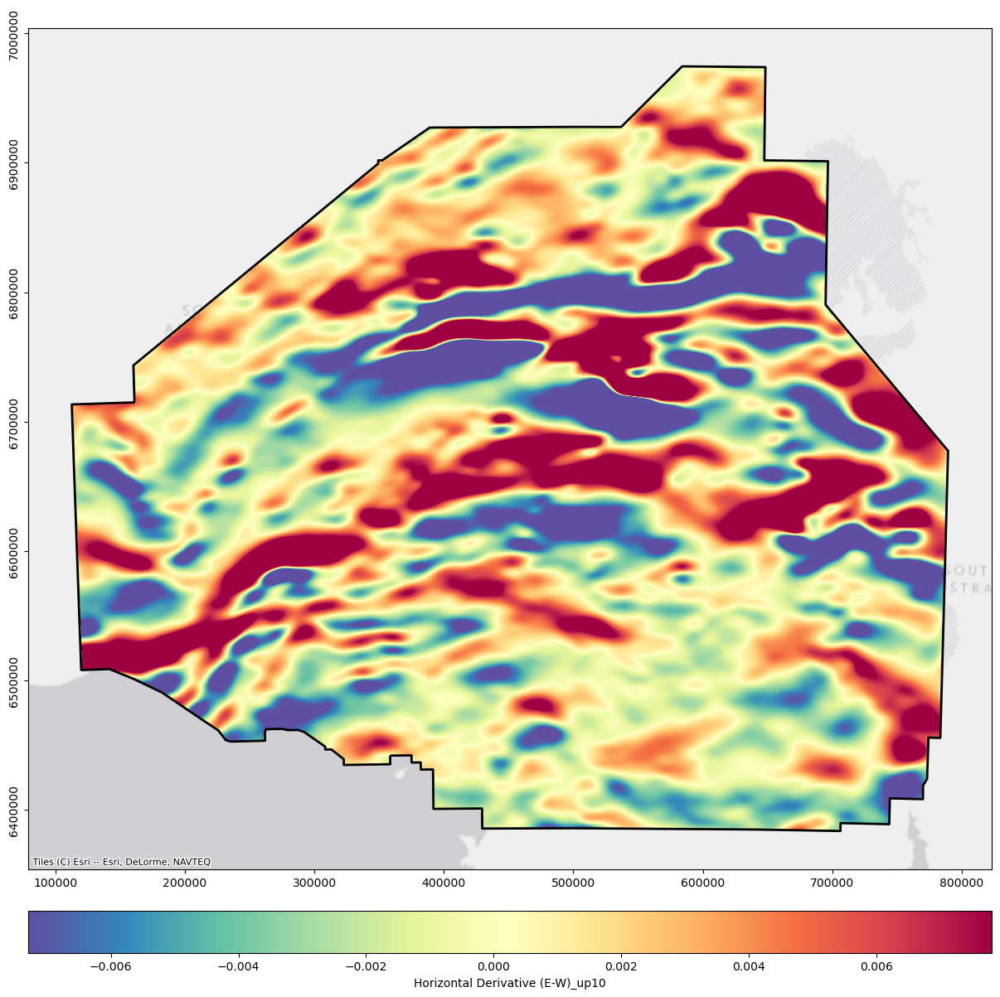

In [53]:
deriv_x_file = './Datasets/Magnetic/New/deriv_x_up10.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up10 = derivative.my_xderiv(lons_2d, lats_2d, upcont10, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up10, np.shape(upcont10))
    save_tiff(derivx_2d, 'deriv_x_up10')

deriv_x_up10 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up10.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative (E-W)_up10')

In [54]:
#Horizontal Derivatives (X) Upward Continuation (20 km)

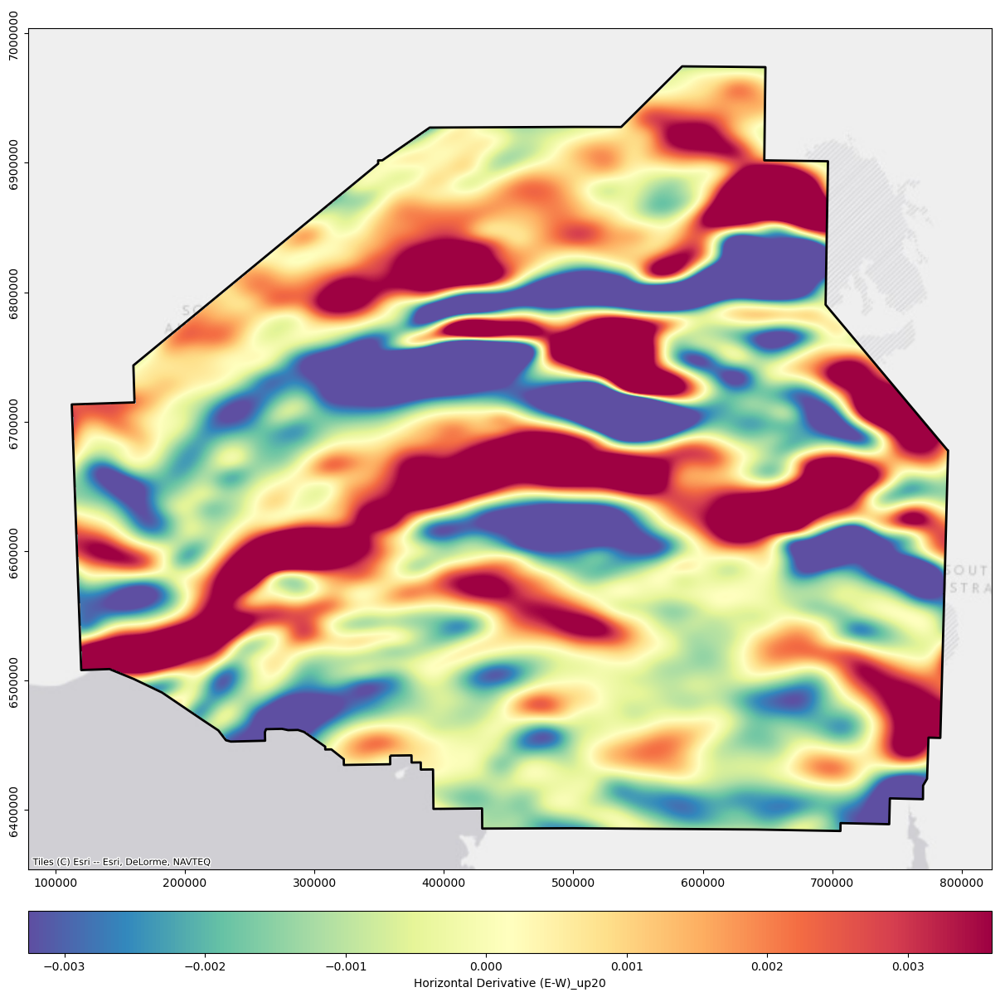

In [55]:
deriv_x_file = './Datasets/Magnetic/New/deriv_x_up20.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up20 = derivative.my_xderiv(lons_2d, lats_2d, upcont20, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up20, np.shape(upcont20))
    save_tiff(derivx_2d, 'deriv_x_up20')

deriv_x_up20 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up20.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative (E-W)_up20')

In [56]:
#Horizontal Derivatives (X) Upward Continuation (30 km)

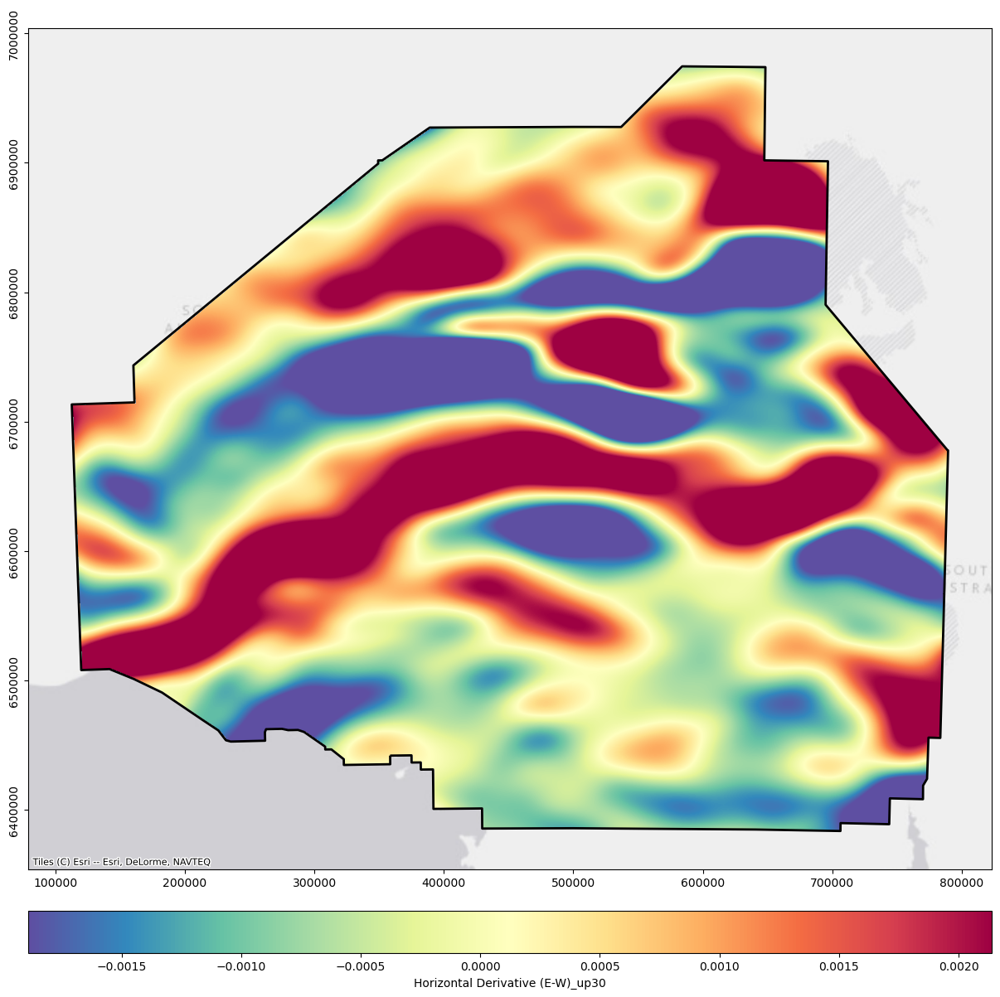

In [57]:
deriv_x_file = './Datasets/Magnetic/New/deriv_x_up30.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up30 = derivative.my_xderiv(lons_2d, lats_2d, upcont30, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up30, np.shape(upcont30))
    save_tiff(derivx_2d, 'deriv_x_up30')

deriv_x_up30 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up30.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative (E-W)_up30')

## Horizontal Derivatives (Y)

In [58]:
# Horizontal Derivatives (Y) Upward Continuation (05 km)

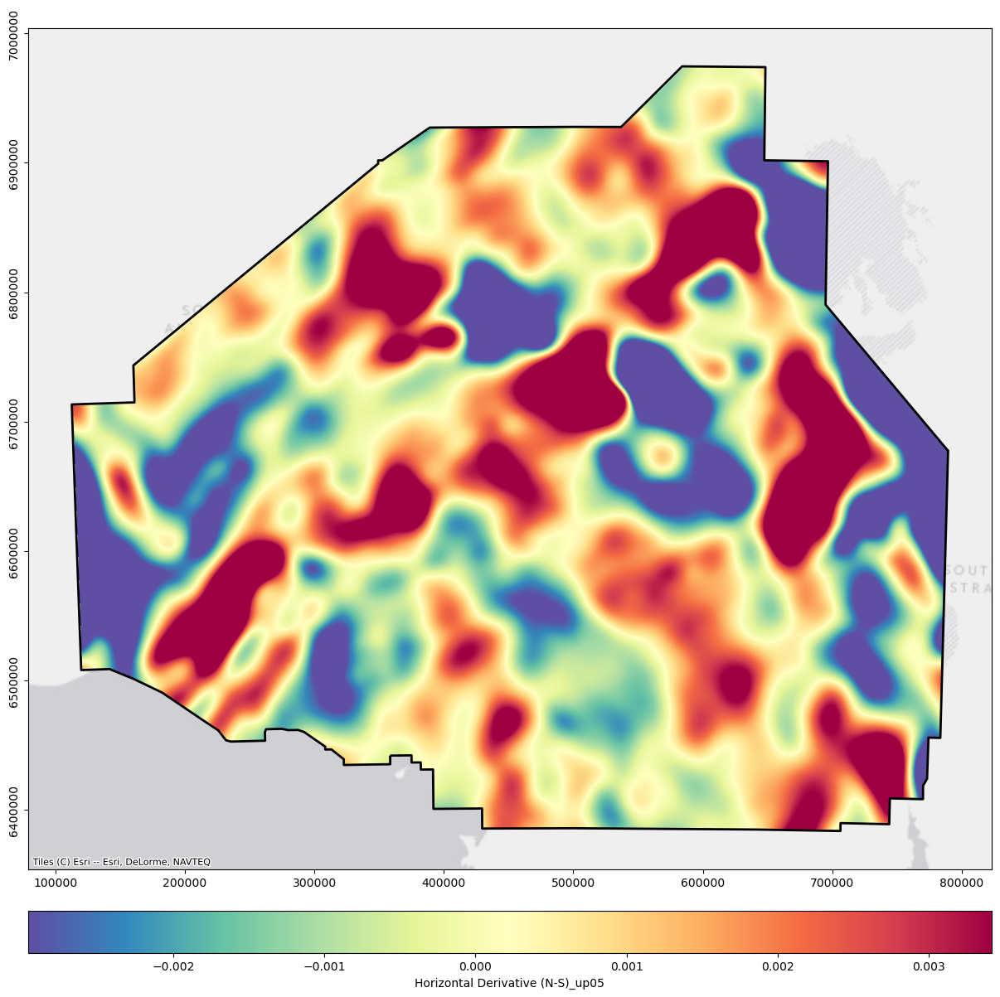

In [59]:
deriv_y_file = './Datasets/Magnetic/New/deriv_y_up05.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up05 = derivative.my_yderiv(lons_2d, lats_2d, upcont05, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up05, np.shape(upcont05))
    save_tiff(derivy_2d, 'deriv_y_up05')

deriv_y_up05 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up05.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative (N-S)_up05')

In [60]:
#Horizontal Derivatives (Y) Upward Continuation (10 km)

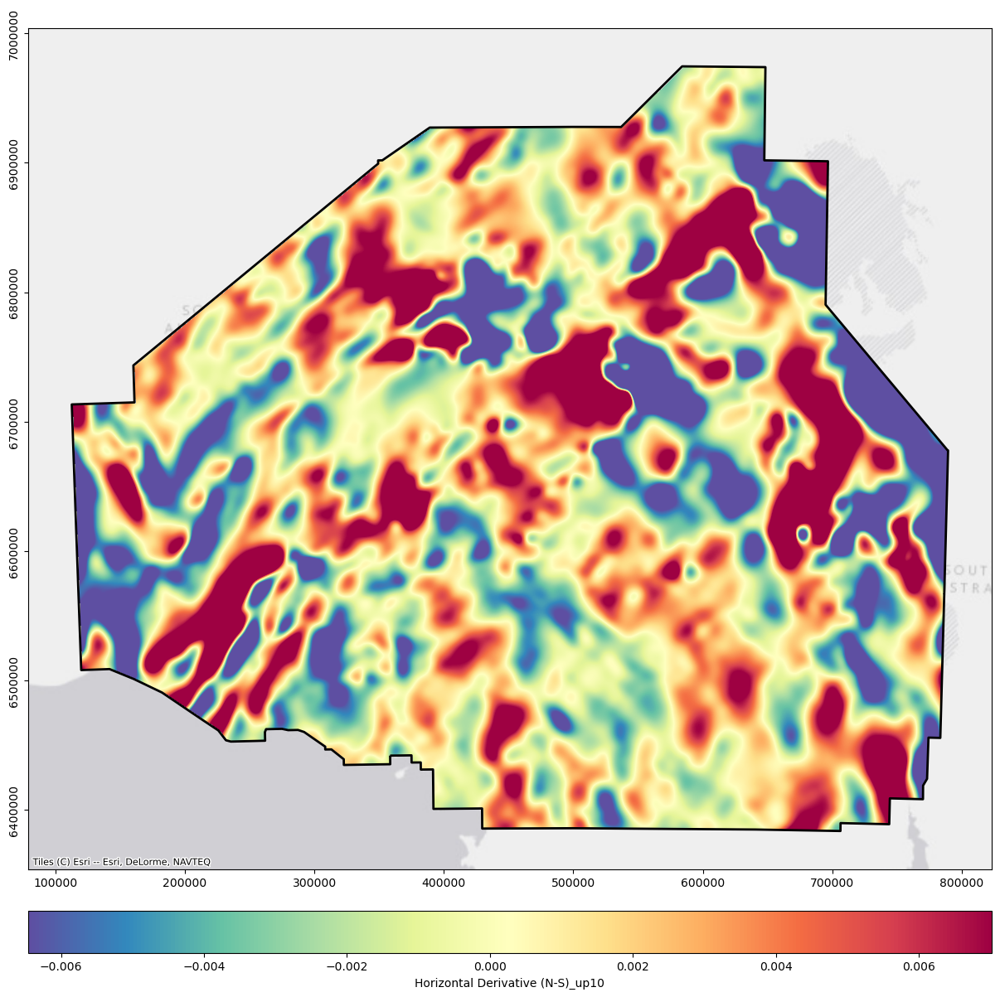

In [61]:
deriv_y_file = './Datasets/Magnetic/New/deriv_y_up10.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up10 = derivative.my_yderiv(lons_2d, lats_2d, upcont10, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up10, np.shape(upcont10))
    save_tiff(derivy_2d, 'deriv_y_up10')

deriv_y_up10 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up10.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative (N-S)_up10')

In [62]:
#Horizontal Derivatives (Y) Upward Continuation (20 km)

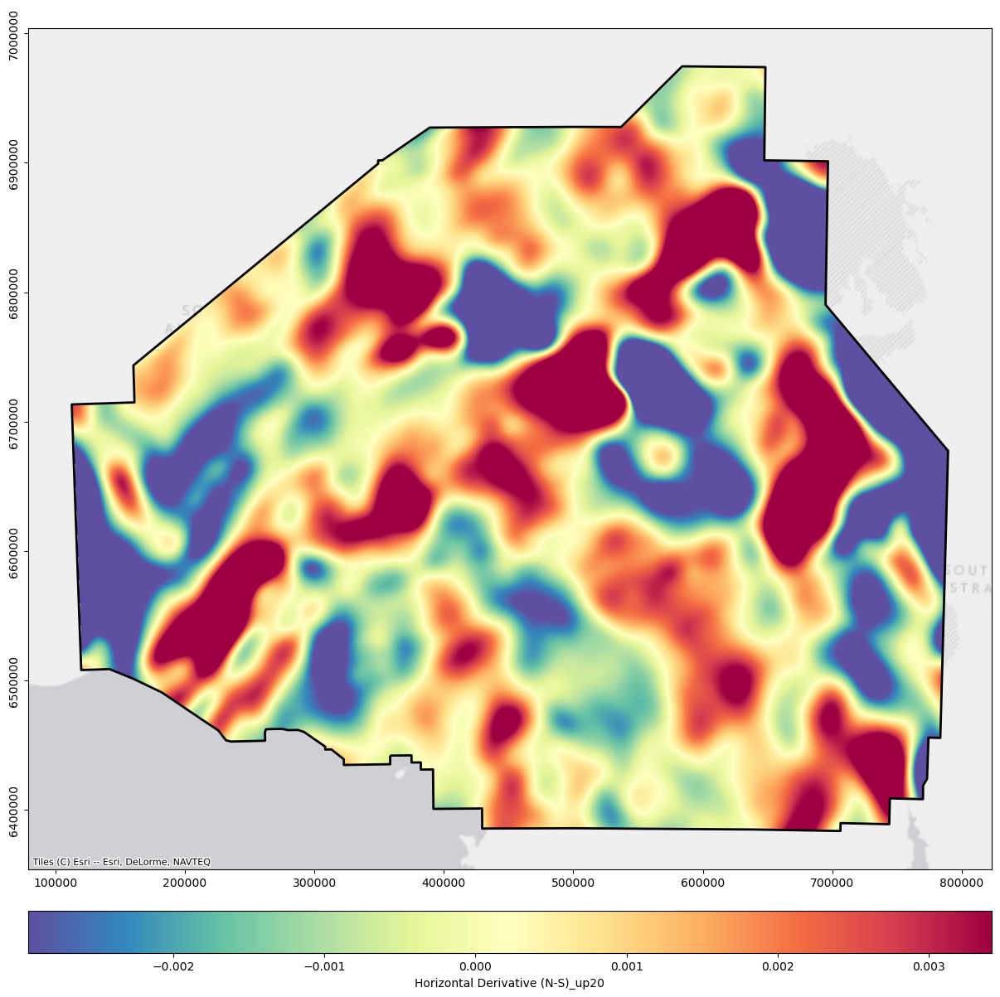

In [63]:
deriv_y_file = './Datasets/Magnetic/New/deriv_y_up20.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up20 = derivative.my_yderiv(lons_2d, lats_2d, upcont20, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up20, np.shape(upcont20))
    save_tiff(derivy_2d, 'deriv_y_up20')

deriv_y_up20 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up20.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative (N-S)_up20')

In [64]:
#Horizontal Derivatives (Y) Upward Continuation (30 km)

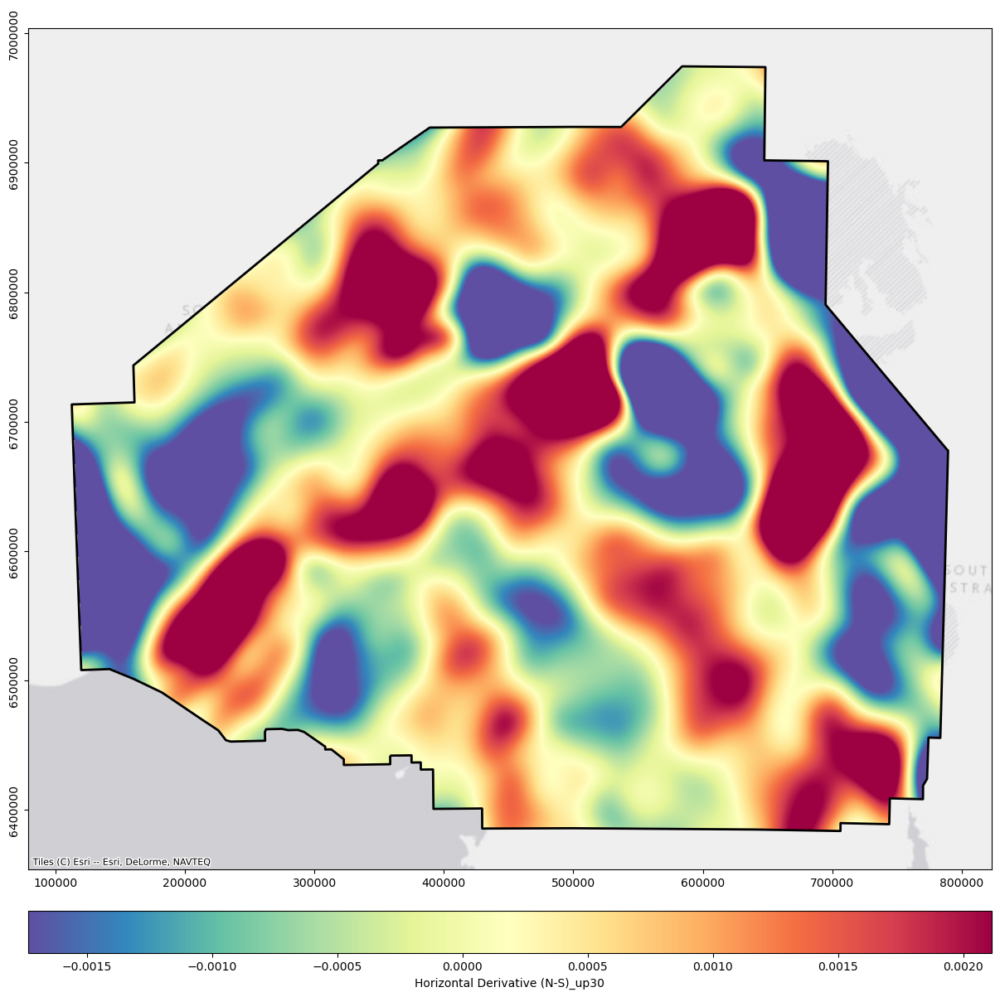

In [65]:
deriv_y_file = './Datasets/Magnetic/New/deriv_y_up30.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up30 = derivative.my_yderiv(lons_2d, lats_2d, upcont30, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up30, np.shape(upcont30))
    save_tiff(derivy_2d, 'deriv_y_up30')

deriv_y_up30 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up30.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative (N-S)_up30')

## Horizontal Derivatives (Gradient Amplitude)

In [66]:
# Horizontal Derivatives (Gradient Amplitude) Upward Continuation (05 km)

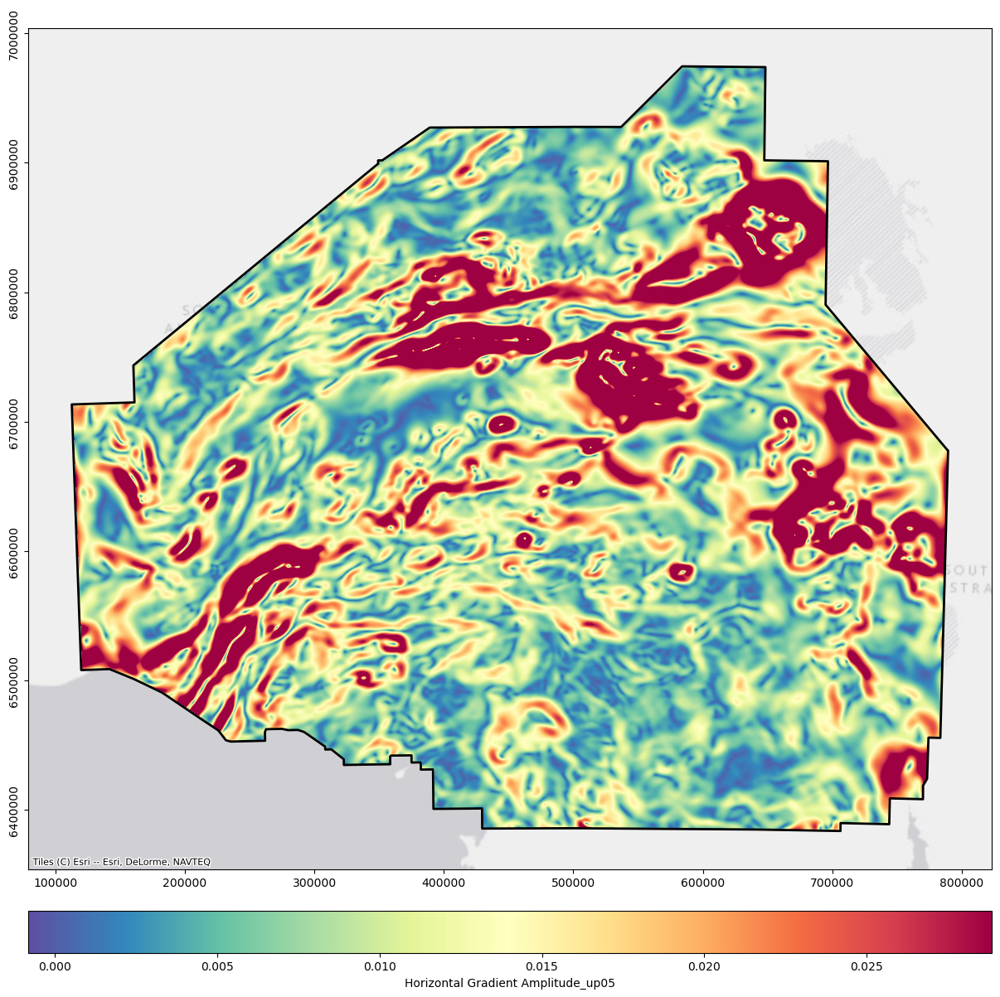

In [67]:
hga_file = './Datasets/Magnetic/New/hga_up05.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up05 = derivative.my_hgrad(lons_2d, lats_2d, upcont05)
    hga_2d = np.reshape(hga_up05, np.shape(upcont05))
    save_tiff(hga_2d, 'hga_up05')

hga_up05 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up05.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up05')

In [68]:
#Horizontal Derivatives (Gradient Amplitude) Upward Continuation (10 km)

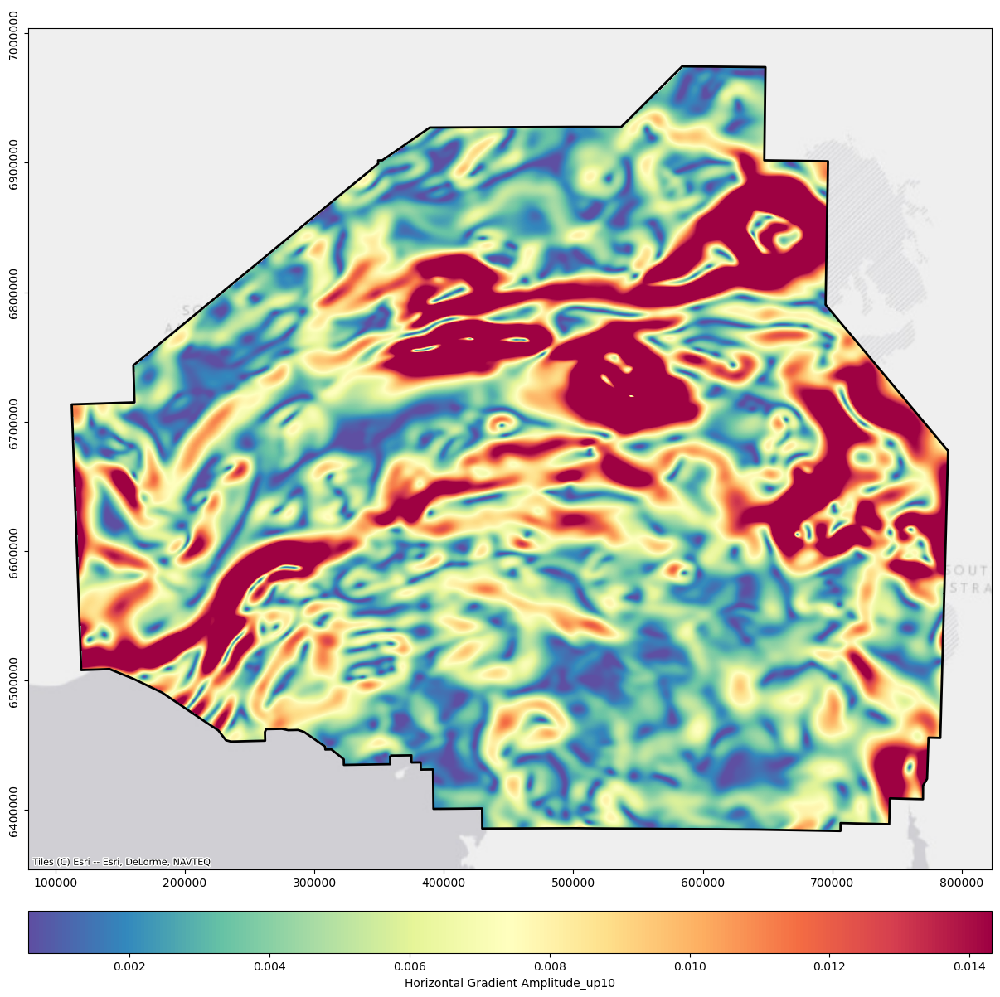

In [69]:
hga_file = './Datasets/Magnetic/New/hga_up10.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up10 = derivative.my_hgrad(lons_2d, lats_2d, upcont10)
    hga_2d = np.reshape(hga_up10, np.shape(upcont10))
    save_tiff(hga_2d, 'hga_up10')

hga_up10 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up10.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up10')

In [70]:
#Horizontal Derivatives (Gradient Amplitude) Upward Continuation (20 km)

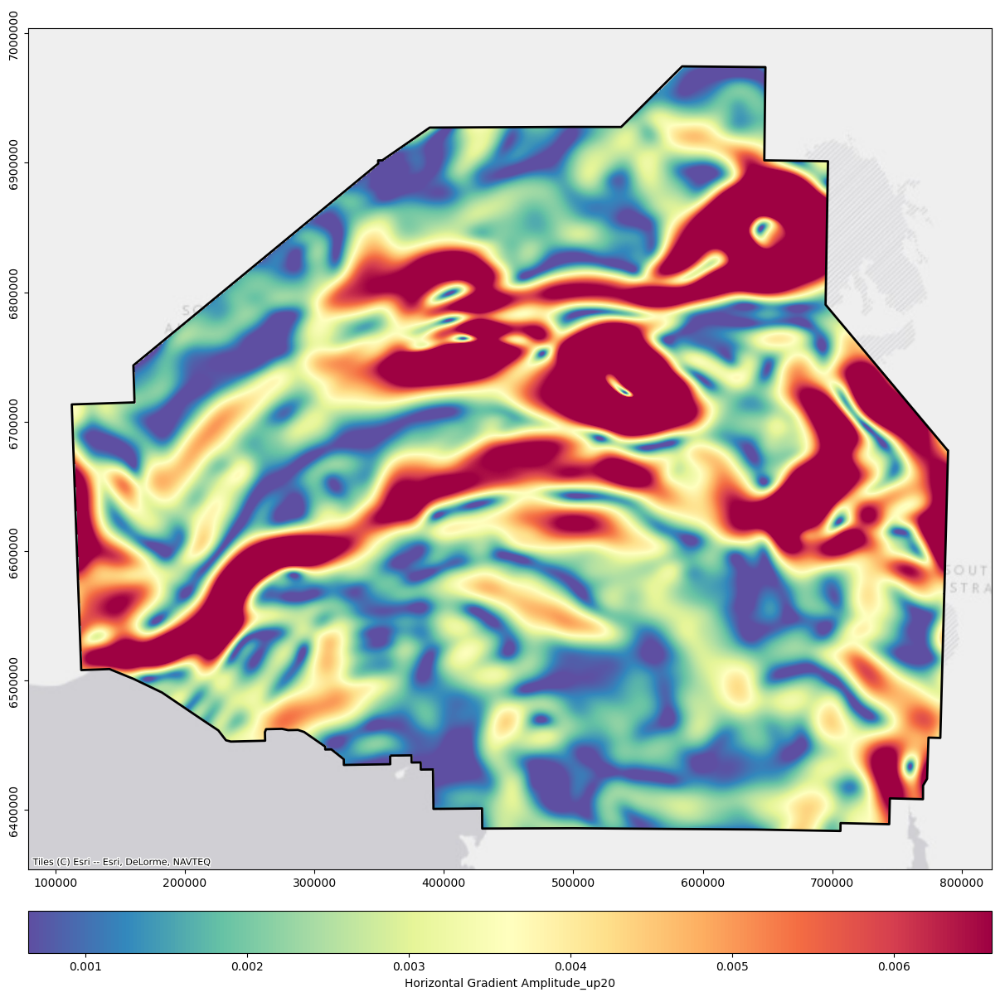

In [71]:
hga_file = './Datasets/Magnetic/New/hga_up20.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up20 = derivative.my_hgrad(lons_2d, lats_2d, upcont20)
    hga_2d = np.reshape(hga_up20, np.shape(upcont20))
    save_tiff(hga_2d, 'hga_up20')

hga_up20 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up20.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up20')

In [72]:
#Horizontal Derivatives (Gradient Amplitude) Upward Continuation (30 km)

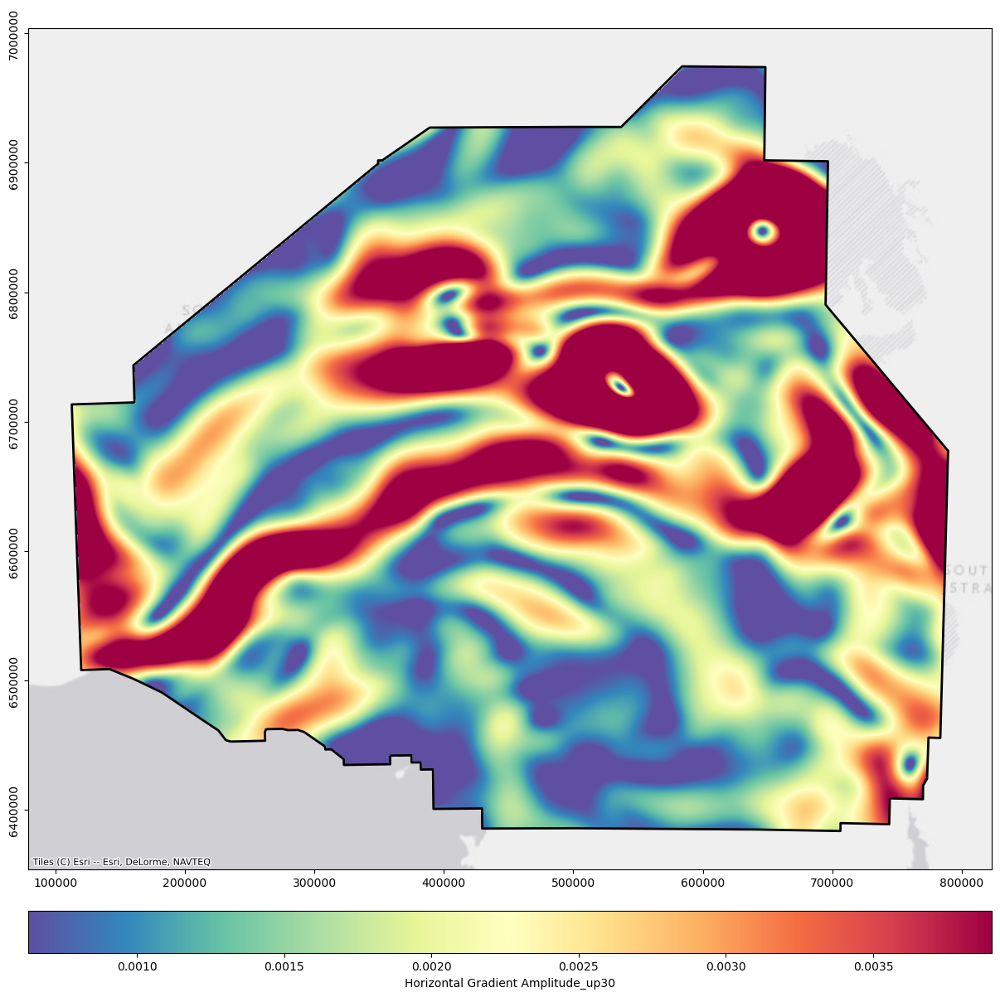

In [73]:
hga_file = './Datasets/Magnetic/New/hga_up30.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up30 = derivative.my_hgrad(lons_2d, lats_2d, upcont30)
    hga_2d = np.reshape(hga_up30, np.shape(upcont30))
    save_tiff(hga_2d, 'hga_up30')

hga_up30 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up30.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up30')

In [74]:
### Local Wavenumber

In [75]:
# local_wavenumber_file = './Datasets/Magnetic/New/local_wavenumber.tiff'

# if not os.path.isfile(local_wavenumber_file):
#     # local wavenumber (K)
#     # depth to source, formulation of Phillips (2002)
#     # grid spacing
#     dx = np.mean(np.diff(lons, axis=0))
#     dy = np.mean(np.diff(lats, axis=0))

#     # formula
#     derivz2 = derivative.my_zderiv(lons_2d, lats_2d, raster_clipped_array, n=2)
#     dzx = np.gradient(derivz, dx)
#     dzy = np.gradient(derivz, dy)

#     d2x = dzx * derivx
#     d2y = dzy * derivy
#     d2z = derivz2 * derivz

#     numerator = (d2x + d2y + d2z)
#     denominator = np.square(derivx) + np.square(derivy) + np.square(derivz)

#     local_wavenumber = numerator / denominator
#     local_wavenumber_2d = np.reshape(local_wavenumber, np.shape(raster_clipped_array))
#     save_tiff(local_wavenumber_2d, 'local_wavenumber')

# local_wavenumber = rxr.open_rasterio(local_wavenumber_file, masked=True).squeeze()
# local_wavenumber_clipped = local_wavenumber.rio.clip(gc_polygon.geometry.apply(mapping))
# local_wavenumber_clipped_array = local_wavenumber_clipped.values
# plot_array_stretched(local_wavenumber_clipped_array, 'Deph to Source')

# Extracting Features from GLCM

In [76]:
def get_grid_data(xs, ys, grids, columns):
    grid_features = []

    for count, grid in enumerate(grids):
        print(count+1, '/', len(grids))
        raster = rxr.open_rasterio(grid, masked=True).squeeze()
        bounds = (raster.rio.bounds())
        raster_np = raster.values
        
        means, stds = get_mean_std(xs, ys, raster_np, bounds, 5000)
        grid_features.append(means)
        grid_features.append(stds)

        dissimilarity, correlation = get_glcm(xs, ys, raster_np, bounds, 10000)
        grid_features.append(dissimilarity)
        grid_features.append(correlation)
        
        del raster
        del raster_np

    return pd.DataFrame(np.array(grid_features).T, columns=columns)

mag_filenames_02 = [
    './Datasets/Magnetic/New/deriv_x_up05.tiff',
    './Datasets/Magnetic/New/deriv_x_up10.tiff',
    './Datasets/Magnetic/New/deriv_x_up20.tiff',
    './Datasets/Magnetic/New/deriv_x_up30.tiff',
    
    './Datasets/Magnetic/New/deriv_y_up05.tiff',
    './Datasets/Magnetic/New/deriv_y_up10.tiff',
    './Datasets/Magnetic/New/deriv_y_up20.tiff',
    './Datasets/Magnetic/New/deriv_y_up30.tiff',
    
    # './Datasets/Magnetic/New/deriv_z.tiff',
    # './Datasets/Magnetic/New/downcont.tiff',
    
    './Datasets/Magnetic/New/upcont05.tiff',
    './Datasets/Magnetic/New/upcont10.tiff',
    './Datasets/Magnetic/New/upcont20.tiff',
    './Datasets/Magnetic/New/upcont30.tiff',
    
    './Datasets/Magnetic/New/hga_up05.tiff',
    './Datasets/Magnetic/New/hga_up10.tiff',
    './Datasets/Magnetic/New/hga_up20.tiff',
    './Datasets/Magnetic/New/hga_up30.tiff',
    
    './Datasets/Magnetic/New/tga_up05.tiff',
    './Datasets/Magnetic/New/tga_up10.tiff',
    './Datasets/Magnetic/New/tga_up20.tiff',
    './Datasets/Magnetic/New/tga_up30.tiff',
    
    './Datasets/Magnetic/New/thd_up05.tiff',
    './Datasets/Magnetic/New/thd_up10.tiff',
    './Datasets/Magnetic/New/thd_up20.tiff',
    './Datasets/Magnetic/New/thd_up30.tiff',
    
    './Datasets/Magnetic/New/tilt_angle_up05.tiff',
    './Datasets/Magnetic/New/tilt_angle_up10.tiff',
    './Datasets/Magnetic/New/tilt_angle_up20.tiff',
    './Datasets/Magnetic/New/tilt_angle_up30.tiff',

    ]

column_names_02 = []

for file in mag_filenames_02:
    prefix = os.path.splitext(os.path.basename(file))[0]
    column_names_02.append(prefix+'_mean')
    column_names_02.append(prefix+'_std')
    column_names_02.append(prefix+'_dissimilarity')
    column_names_02.append(prefix+'_correlation')

mag_features_file_02 = './Magnetic Features_04.csv'

if os.path.isfile(mag_features_file_02):
    print('The magnetic features (new data layers) already exist.')
    mag_features_02 = pd.read_csv(mag_features_file_02, index_col=False)
else:
    mag_features_02 = get_grid_data(xs_flat, ys_flat, mag_filenames_02, column_names_02)
    mag_features_02.to_csv(mag_features_file_02, index=False)
    print(f'The magnetic features (new data layers) have been saved to {mag_features_file_02}.')

@interact(feature=column_names_02)
def show_dist(feature):
    array = np.flipud(mag_features_02[feature].values.reshape(ny, nx))
    array_copy = array.copy()
    array_copy[~mask_2d_ud] = float('nan')
    plot_array_stretched(array_copy, feature)

The magnetic features (new data layers) already exist.


interactive(children=(Dropdown(description='feature', options=('deriv_x_up05_mean', 'deriv_x_up05_std', 'deriv…

# PCA

In [77]:
mag_features_file = './Magnetic Features_04.csv'

if os.path.isfile(mag_features_file):
    print('The magnetic features already exist.')
    mag_features = pd.read_csv(mag_features_file, index_col=False)
else:
    mag_features = pd.concat([mag_features_01, mag_features_02], axis=1).reset_index(drop=True)
    mag_features.to_csv(mag_features_file, index=False)
    print(f'The magnetic features have been saved to {mag_features_file}.')

# pca
pca = PCA()
components = pca.fit_transform(mag_features)
var_ratio = pca.explained_variance_ratio_
var_sum = 0

for i in range(len(var_ratio)):
    if var_sum >= 0.99:
        break
    else:
        var_sum += var_ratio[i]

selected_components = components[:, :i]
print('Number of input features:', mag_features.shape[1])
print('Number of components:', selected_components.shape[1])

@interact(pc_num=list(range(1, selected_components.shape[1]+1)))
def show_map(pc_num):
    pc = selected_components[:, pc_num-1]
    pc_2d = np.reshape(pc, (ny, nx))
    pc_2d_ud = np.flipud(pc_2d)
    pc_2d_ud_copy = pc_2d_ud.copy()
    pc_2d_ud_copy[~mask_2d_ud] = float('nan')
    plot_array_stretched(pc_2d_ud_copy, 'PC')

The magnetic features already exist.
Number of input features: 112
Number of components: 2


interactive(children=(Dropdown(description='pc_num', options=(1, 2), value=1), Output()), _dom_classes=('widge…

# Elbow Method

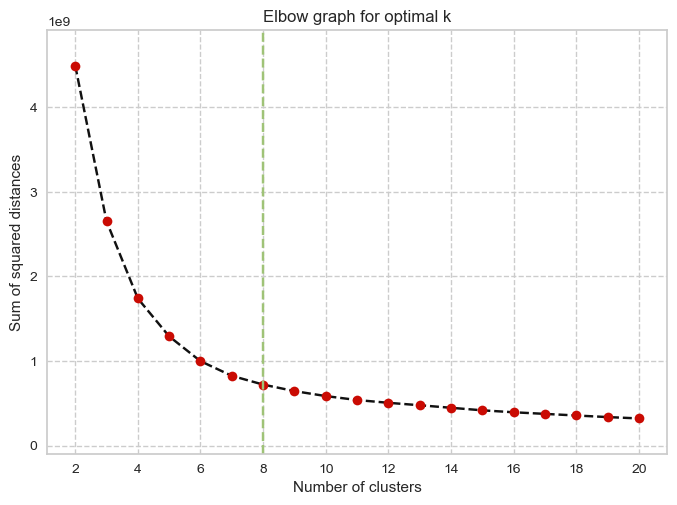

In [78]:
from yellowbrick.cluster import KElbowVisualizer

# two options for plotting the elbow graph
# option 1 without using the yellowbrick library
sum_squared_distance = []
range_n_clusters = range(2, 21)
for k in range_n_clusters:
    clusterer = cluster.KMeans(n_clusters=k, random_state=1)
    clusterer.fit(selected_components)
    sum_squared_distance.append(clusterer.inertia_)

range_ssd = max(sum_squared_distance) - min(sum_squared_distance)

plt.plot(range_n_clusters, sum_squared_distance, 'ko--', mfc='r')
plt.vlines(x=8, ymin=min(sum_squared_distance)-(0.1*range_ssd),
           ymax=max(sum_squared_distance)+(0.1*range_ssd), color='g', linestyles='dashed')
plt.xticks(range(2, 21, 2))
plt.ylim(min(sum_squared_distance)-(0.1*range_ssd), max(sum_squared_distance)+(0.1*range_ssd))
plt.xlabel('Number of clusters')
plt.ylabel('Sum of squared distances')
plt.title('Elbow graph for optimal k')
plt.grid(linestyle='--')
plt.show()

# # option 2 using the yellowbrick library
# visualizer = KElbowVisualizer(cluster.KMeans(random_state=1), k=(2, 21), timings=True)
# # fit the data
# visualizer.fit(selected_components)
# # finalize and render figure
# visualizer.show()

# Clustering k-means

## Optimization of Hyperparameters

In [79]:
%%time
from sklearn import cluster
from sklearn.metrics import silhouette_score
import random

# Define hyperparameter ranges
n_init_range = range(1, 10, 2)  # From 1 to 10 with intervals of 2
max_iter_range = range(1, 1000, 100)  # From 1 to 1000 with intervals of 100
tolerance_range = np.arange(1, 10, 2)  # From 1 to 10 with intervals of 2

# Fixed hyperparameters
n_clusters = 8  # Number of clusters
init_method = 'k-means++'  # Method for initialization
random_state = 1  # Random state for reproducibility

# Select a random subset of parameter combinations
random_init = random.sample(list(n_init_range), 3)
random_max_iter = random.sample(list(max_iter_range), 3)
random_tolerance = random.sample(list(tolerance_range), 3)

# Initialize variables to store the best parameters and performance
best_score = -1
best_params = {}

# Loop over all parameter combinations
for n_init, max_iter, tolerance in zip(random_init, random_max_iter, random_tolerance):
    # k-means clustering using the components
    k_means = cluster.KMeans(n_clusters=n_clusters, init=init_method, n_init=n_init,
                             max_iter=max_iter, tol=tolerance, random_state=random_state)

    # Train the model
    pred = k_means.fit_predict(selected_components)

    # Compute silhouette score
    score = silhouette_score(selected_components, pred)
    
    # Update best parameters if the current silhouette score is higher
    if score > best_score:
        best_score = score
        best_params = {'n_init': n_init, 'max_iter': max_iter, 'tolerance': tolerance}

# Print the best parameters and performance
print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_score)

KeyboardInterrupt: 

In [80]:
# Define hyperparameter ranges
# n_init_range = range(1, 10, 2)  # From 1 to 10 with intervals of 2
# max_iter_range = range(1, 1000, 100)  # From 1 to 1000 with intervals of 100
# tolerance_range = np.arange(1, 10, 2)  # From 1 to 10 with intervals of 2
#1)
# Best Parameters: {'n_init': 5, 'max_iter': 601, 'tolerance': 1}
# Best Silhouette Score: 0.38102896798948654
# CPU times: total: 14min 4s
# Wall time: 9min 11s
#2)
# Best Parameters: {'n_init': 7, 'max_iter': 101, 'tolerance': 1}
# Best Silhouette Score: 0.38102896798948654
# CPU times: total: 13min 38s
# Wall time: 8min 53s
#3)
# Best Parameters: {'n_init': 9, 'max_iter': 201, 'tolerance': 5}
# Best Silhouette Score: 0.38102896798948654
# CPU times: total: 16min 37s
# Wall time: 11min 16s
# 4)
#Best Parameters: {'n_init': 3, 'max_iter': 801, 'tolerance': 5}
# Best Silhouette Score: 0.38102896798948654
# CPU times: total: 15min 48s
# Wall time: 6min 26s

#-----------------------------------------------------------------------------------------
# # Define hyperparameter ranges
# n_init_range = range(1, 11, 2)  # From 1 to 10 with intervals of 2
# max_iter_range = range(10, 101, 10)  # From 10 to 100 with intervals of 10
# tolerance_range = np.arange(0.0001, 0.0011, 0.0001)  # From 0.0001 to 0.001 with intervals of 0.0001

# 1) Best Parameters: {'n_init': 7, 'max_iter': 40, 'tolerance': 0.0006000000000000001}
    #Best Silhouette Score: 0.3964394029082373
# 2) Best Parameters: {'n_init': 1, 'max_iter': 40, 'tolerance': 0.0008}
    #Best Silhouette Score: 0.3964394029082373
#3) Best Parameters: {'n_init': 7, 'max_iter': 80, 'tolerance': 0.0004}
    #Best Silhouette Score: 0.39624792329158315
#4) Best Parameters: {'n_init': 1, 'max_iter': 60, 'tolerance': 0.0006000000000000001}
    #Best Silhouette Score: 0.3964394029082373
#CPU times: total: 12min 6s
#Wall time: 5min 5s 

## k-means clustering result

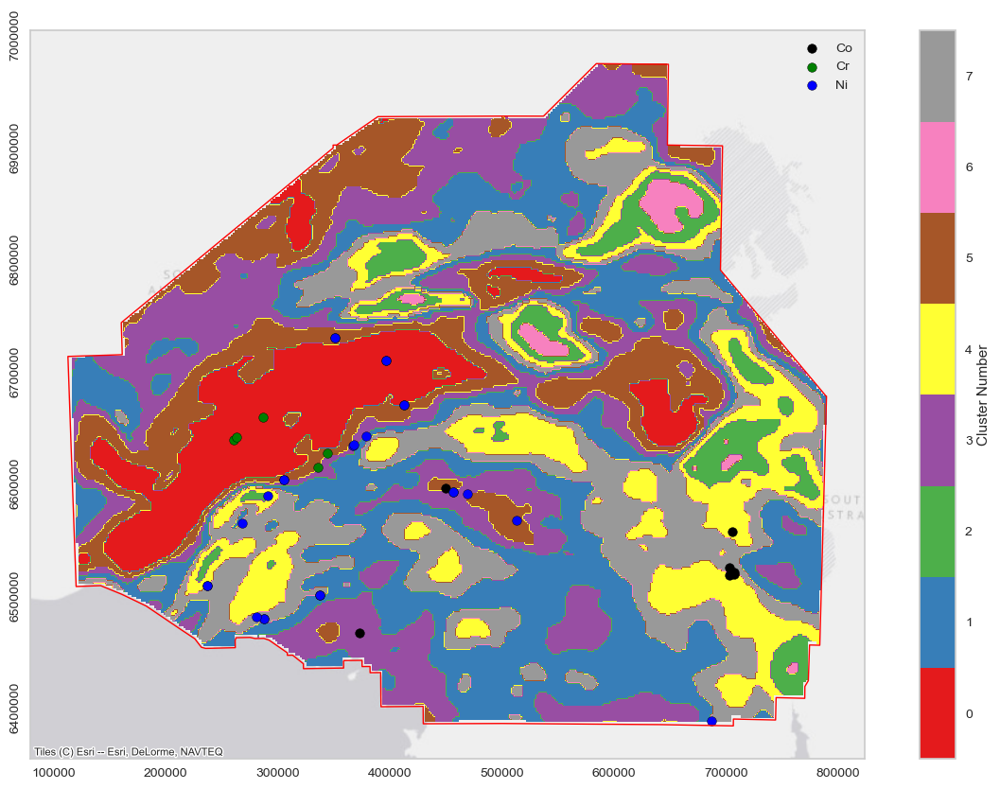

In [87]:
from sklearn import cluster
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import contextily as cx
from matplotlib import cm

# Fixed hyperparameters for KMeans with adjusted speed
n_clusters = 8  # Number of clusters
init_method = 'k-means++'  # Method for initialization
n_init = 3  # Number of times the k-means algorithm will be run with different centroid seeds (reduced from 10)
max_iter = 801  # Maximum number of iterations of the k-means algorithm for a single run (reduced from 300)
tolerance = 5  # Tolerance to declare convergence

# k-means clustering using the components generated in the previous cell
k_means = cluster.KMeans(n_clusters=n_clusters, init=init_method, n_init=n_init,
                         max_iter=max_iter, tol=tolerance, random_state=1)

# Train the model
pred = k_means.fit_predict(selected_components)

# Get cluster labels
labels = k_means.labels_

# Reshape labels
labels = labels.reshape((ny, nx))
labels = labels.astype('float')
labels = np.flipud(labels)
labels[~mask_2d_ud] = float('nan')

# Plotting
fig, ax = plt.subplots(figsize=(15, 10))
mines_co.plot(ax=ax, edgecolor='black', color='black')
mines_cr.plot(ax=ax, edgecolor='black', color='green')
mines_ni.plot(ax=ax, edgecolor='black', color='blue')
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
cmap = cm.get_cmap('Set1', n_clusters)
plt.imshow(labels, cmap=cmap, extent=extent)
cbar = plt.colorbar(label='Cluster Number')
tick_locs = (np.arange(n_clusters) + 0.5)*(n_clusters-1)/n_clusters
cbar.set_ticks(tick_locs)
cbar.set_ticklabels(np.arange(n_clusters))
plt.legend(['Co', 'Cr', 'Ni'])
plt.grid(False)
plt.show()

In [88]:
# Get the unique values in som_labels as a list
unique_values_list = np.unique(labels).tolist()
print("Unique values in labels:", unique_values_list)
print("Number of unique values:", len(unique_values_list))

Unique values in labels: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, nan]
Number of unique values: 9


In [83]:
# from sklearn.metrics import silhouette_score

# # Flatten the labels and input data arrays
# flattened_labels =labels.flatten()
# flattened_data = selected_components.reshape(-1, len(selected_components[0]))

# # Remove NaN values from the input data and corresponding labels
# valid_indices = ~np.isnan(flattened_labels)
# X_valid = flattened_data[valid_indices]
# labels_valid = flattened_labels[valid_indices]

# # Calculate silhouette score
# silhouette_avg = silhouette_score(X_valid, labels_valid)

# print("Silhouette Score:", silhouette_avg)

In [89]:
# export an array to a GeoTIFF file
def save_tiff_output(array, index):
    dist_x = 2000
    dist_y = 2000
    geotransform = (extent[0], dist_x, 0, extent[3], 0, -dist_y)
    map_file = f'./Datasets/Output/{index}.tiff'
    driver = gdal.GetDriverByName('GTiff')
    nx = array.shape[1]
    ny = array.shape[0]
    dataset = driver.Create(map_file, nx, ny, 1, gdal.GDT_Float32)
    dataset.SetGeoTransform(geotransform)
    srs = osr.SpatialReference()
    srs.ImportFromEPSG(7853)
    dataset.SetProjection(srs.ExportToWkt())
    dataset.GetRasterBand(1).WriteArray(array)
    dataset.FlushCache()
    dataset = None

In [91]:
save_tiff_output(labels, 'Deep_Mag_Kmeans')

# Clustering SOM

## Optimization of Hyperparameters

In [86]:
from minisom import MiniSom
from sklearn.metrics import silhouette_score
import numpy as np
import random

input_len = len(selected_components[0])  # Adjust this according to your input data dimensionality

# Define the parameter ranges
som_rows_range = list(range(5, 31, 5))
som_cols_range = list(range(5, 31, 5))
sigma_range = list(range(1, 10, 2))
learning_rate_range = list(np.arange(0, 1.1, 0.2))
iterations_range = list(range(100, 1001, 200))

# Randomly sample a subset of parameter combinations
parameter_combinations = list(zip(random.sample(som_rows_range, 3),
                                  random.sample(som_cols_range, 3),
                                  random.sample(sigma_range, 3),
                                  random.sample(learning_rate_range, 3),
                                  random.sample(iterations_range, 3)))

# Initialize variables to store the best parameters and performance
best_params = {}
best_performance = -1  # Initialize with a low value as silhouette score ranges from -1 to 1 (higher is better)

# Loop over all parameter combinations
for som_rows, som_cols, sigma, learning_rate, iterations in parameter_combinations:
    # Initialize the SOM
    som = MiniSom(som_rows, som_cols, input_len, sigma=sigma, learning_rate=learning_rate)
    
    # Train the SOM with current parameters
    som.train_batch(selected_components, iterations)
    
    # Assign each sample to its closest neuron
    pred = np.array([som.winner(x) for x in selected_components])
    
    # Flatten the SOM grid to get cluster labels
    som_labels = np.ravel_multi_index(pred.T, (som_rows, som_cols))
    
    # Compute silhouette score
    silhouette = silhouette_score(selected_components, som_labels)
    
    # Update best parameters if the current silhouette score is higher
    if silhouette > best_performance:
        best_params = {'som_rows': som_rows, 'som_cols': som_cols, 'sigma': sigma, 'learning_rate': learning_rate, 'iterations': iterations}
        best_performance = silhouette

# Print the best parameters and performance
print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_performance)

KeyboardInterrupt: 

In [ ]:
#1) Best Parameters: {'som_rows': 10, 'som_cols': 10, 'sigma': 15, 'learning_rate': 0.8, 'iterations': 500}
     #Best Silhouette Score: -0.135305883242619
#2) Best Parameters: {'som_rows': 20, 'som_cols': 25, 'sigma': 10, 'learning_rate': 0.2, 'iterations': 500}
    #Best Silhouette Score: -0.07105759955421231
#3) Best Parameters: {'som_rows': 20, 'som_cols': 20, 'sigma': 15, 'learning_rate': 0.2, 'iterations': 900}
    #Best Silhouette Score: -0.10833716763491273
# 4) Best Parameters: {'som_rows': 10, 'som_cols': 10, 'sigma': 15, 'learning_rate': 1.0, 'iterations': 300}
    #Best Silhouette Score: -0.041357771276298756
#5) Best Parameters: {'som_rows': 25, 'som_cols': 20, 'sigma': 3, 'learning_rate': 0.6000000000000001, 'iterations': 700}
#Best Silhouette Score: 0.03456163798333872

## SOM Clustering result

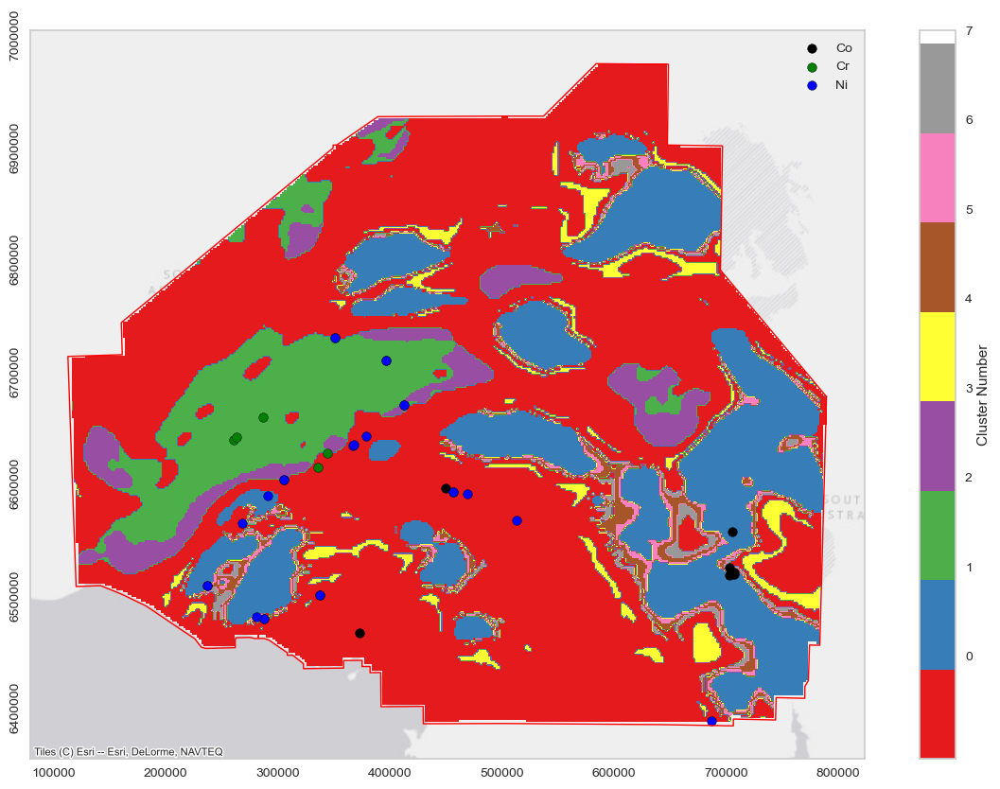

In [92]:
from minisom import MiniSom
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import contextily as cx
from matplotlib import cm
from collections import Counter  # Import Counter class

# Define SOM parameters
som_rows = 25  # Adjust the number of rows
som_cols = 20  # Adjust the number of columns
input_len = len(selected_components[0])  # Adjust this according to your input data dimensionality
sigma = 3  # Spread of the neighborhood function, adjust as needed
learning_rate = 0.6
num_clusters = 8  # Number of clusters

# Initialize the SOM
som = MiniSom(som_rows, som_cols, input_len, sigma=sigma, learning_rate=learning_rate)

# Train the SOM
som.train_batch(selected_components, 700)  # Adjust the number of iterations (2000 is an example)

# Assign each sample to its closest neuron
pred = np.array([som.winner(x) for x in selected_components])

# Flatten the SOM grid to get cluster labels
som_labels = np.ravel_multi_index(pred.T, (som_rows, som_cols))

# Find the top 8 most frequent cluster labels
top_labels = [label for label, count in Counter(som_labels).most_common(7)]

# Assign data points to the top 8 labels
som_labels = np.array([top_labels.index(label) if label in top_labels else -1 for label in som_labels])

# Reshape labels
som_labels = som_labels.reshape((ny, nx))
som_labels = som_labels.astype('float')
som_labels = np.flipud(som_labels)
som_labels[~mask_2d_ud] = float('nan')

# Plotting
fig, ax = plt.subplots(figsize=(15, 10))
mines_co.plot(ax=ax, edgecolor='black', color='black')
mines_cr.plot(ax=ax, edgecolor='black', color='green')
mines_ni.plot(ax=ax, edgecolor='black', color='blue')
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
cmap = cm.get_cmap('Set1', num_clusters)  # Adjust the number of clusters here
plt.imshow(som_labels, cmap=cmap, extent=extent)
cbar = plt.colorbar(label='Cluster Number')
tick_locs = (np.arange(num_clusters) + 0.005) * (num_clusters - 1) / num_clusters
cbar.set_ticks(tick_locs)
cbar.set_ticklabels(np.arange(num_clusters))
plt.legend(['Co', 'Cr', 'Ni'])
plt.grid(False)
plt.show()

In [93]:
# Get the unique values in som_labels as a list
unique_values_list = np.unique(som_labels).tolist()
print("Unique values in som_labels:", unique_values_list)
print("Number of unique values:", len(unique_values_list))

Unique values in som_labels: [-1.0, 0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, nan]
Number of unique values: 9


In [94]:
save_tiff_output(som_labels, 'Deep_Mag_SOM')

In [ ]:

#To improve the result of the SOM classification, you can manipulate several hyperparameters. Here are some key hyperparameters you can experiment with:

#SOM grid size (som_rows and som_cols): Adjusting the size of the SOM grid can affect the granularity of the clustering. A larger grid can capture more complex patterns in the data but may also lead to overfitting, while a smaller grid may result in oversimplified clustering.

#Learning rate (learning_rate): This parameter controls the step size of the weight updates during training. A higher learning rate can lead to faster convergence but may also cause instability. Conversely, a lower learning rate can result in slower convergence but may yield better clustering results, especially when the data has complex patterns.

#Neighborhood function spread (sigma): This parameter determines the spread of the neighborhood function, which defines the influence of neighboring neurons during training. A larger sigma value leads to a broader influence, allowing for more global updates to the weights. Experimenting with different sigma values can help balance between capturing local and global patterns in the data.

#Number of training iterations: The number of training iterations (epochs) determines how many times the algorithm iterates over the entire dataset. Increasing the number of iterations allows the SOM to refine the cluster representations further. However, be cautious of overfitting if the number of iterations is too high.

#Initialization of weights: The initial weights of the neurons can affect the convergence and final clustering quality. Experimenting with different initialization methods, such as random initialization or using a subset of the data as initial weights, may lead to better results.

#Normalization of input data: Normalizing the input data to have zero mean and unit variance can improve convergence and clustering quality, especially when features have different scales.

#Distance metric: The choice of distance metric used to measure the similarity between data points and neurons can impact the clustering results. While the Euclidean distance is commonly used, experimenting with alternative distance metrics such as Manhattan distance or cosine similarity may be beneficial depending on the characteristics of the data.

#When experimenting with hyperparameters, it's essential to monitor the clustering performance using relevant metrics (e.g., silhouette score, Davies–Bouldin index) and visualize the resulting clusters to assess their quality. Additionally, consider cross-validation to evaluate the generalization performance of the model on unseen data.

In [ ]:
#Evaluate the Efficiency of SOM clustering algorithm

In [ ]:
#Calculate the silhouette score for the clustering result.
#Interpret the silhouette score:
#A silhouette score close to +1 indicates that the sample is far away from neighboring clusters.
#A silhouette score close to 0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters.
#A silhouette score close to -1 indicates that the sample is within the cluster boundary.
#Experiment with different hyperparameters of the SOM (e.g., grid size, learning rate, sigma) to maximize the silhouette score.

In [ ]:
# from sklearn.metrics import silhouette_score

# # Flatten the labels and input data arrays
# flattened_labels = som_labels.flatten()
# flattened_data = selected_components.reshape(-1, len(selected_components[0]))

# # Remove NaN values from the input data and corresponding labels
# valid_indices = ~np.isnan(flattened_labels)
# X_valid = flattened_data[valid_indices]
# labels_valid = flattened_labels[valid_indices]

# # Calculate silhouette score
# silhouette_avg = silhouette_score(X_valid, labels_valid)

# print("Silhouette Score:", silhouette_avg)


In [ ]:
#Davies–Bouldin index
#The Davies–Bouldin index measures the average similarity between each cluster and its most similar cluster, compared to the average dissimilarity between clusters. It ranges from 0 to infinity, where lower values indicate better clustering. A lower index indicates that clusters are dense and well-separated, while a higher index suggests that clusters are less compact and more spread out.
#In general, a lower silhouette score and a lower Davies–Bouldin index indicate better clustering performance. However, it's essential to consider the characteristics of your data and the specific clustering problem. For example:
#If your data has well-defined clusters and you're aiming for compact, well-separated clusters, a lower Davies–Bouldin index might be preferable.
#If your clusters are less compact or overlapping, or if you're interested in the individual objects' placement within clusters, the silhouette score might be more informative

In [ ]:
# from sklearn.metrics import davies_bouldin_score

# # Flatten the labels and input data arrays
# flattened_labels = mapped_labels.flatten()
# flattened_data = selected_components.reshape(-1, len(selected_components[0]))

# # Remove NaN values from the input data and corresponding labels
# valid_indices = ~np.isnan(flattened_labels)
# X_valid = flattened_data[valid_indices]
# labels_valid = flattened_labels[valid_indices]

# # Calculate Davies–Bouldin index
# db_score = davies_bouldin_score(X_valid, labels_valid)

# print("Davies–Bouldin index:", db_score)


In [ ]:
#The Calinski-Harabasz Score (also known as the Variance Ratio Criterion) is a metric used to evaluate the goodness of a clustering algorithm. It compares the ratio of between-cluster dispersion to within-cluster dispersion. Higher values of the Calinski-Harabasz Score indicate better-defined, more separated clusters.

In [ ]:
# from sklearn.metrics import calinski_harabasz_score

# # Assuming 'mapped_labels' contains the cluster labels obtained from SOM clustering

# # Flatten the labels and input data arrays
# flattened_labels = mapped_labels.flatten()
# flattened_data = selected_components.reshape(-1, len(selected_components[0]))

# # Remove NaN values from the input data and corresponding labels
# valid_indices = ~np.isnan(flattened_labels)
# X_valid = flattened_data[valid_indices]
# labels_valid = flattened_labels[valid_indices]

# # Calculate Calinski-Harabasz Score
# ch_score = calinski_harabasz_score(X_valid, labels_valid)

# print('Calinski-Harabasz Score:', ch_score)
